## poliastro 构建的轨道传播算法 只考虑了J2

In [1]:
import numpy as np
from joblib import Parallel, delayed
from sklearn.base import BaseEstimator
# Astrodynamics libraries
from astropy import units as u
from astropy.time import Time
from poliastro.bodies import Earth, Sun
from poliastro.twobody import Orbit
from poliastro.twobody.propagation import cowell
from poliastro.core.perturbations import J2_perturbation
# from numba import njit
from poliastro.core.propagation import func_twobody

from astropy import units as u
from poliastro.bodies import Earth, Mars, Sun
from poliastro.twobody import Orbit
import numpy as np
import random
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline


import numpy as np
from joblib import Parallel, delayed
from sklearn.base import BaseEstimator
# Astrodynamics libraries
from astropy import units as u
from astropy.time import Time
from poliastro.bodies import Earth, Sun
from poliastro.twobody import Orbit
from poliastro.twobody.propagation import cowell
from poliastro.core.perturbations import J2_perturbation
# from numba import njit
from poliastro.core.propagation import func_twobody

from astropy import units as u
from poliastro.bodies import Earth, Mars, Sun
from poliastro.twobody import Orbit
import numpy as np
import random
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline


prop_time = 2

def f(t0, u_, k):
    du_kep = func_twobody(t0, u_, k)
    ax, ay, az = J2_perturbation(
        t0, u_, k, J2=Earth.J2.value, R=Earth.R.to(u.km).value
    )
    du_ad = np.array([0, 0, 0, ax, ay, az])
    return du_kep + du_ad


def prop(state):
    s = prop_time

    r = state[0:3] * u.m
    v = state[3:6] * (u.m / u.s)
    orbit = Orbit.from_vectors(Earth, r, v)
    prop_orbit = orbit.propagate(s * u.s,
                                 method=cowell, f=f)

    prop_r, prop_v = prop_orbit.rv()
    prop_state_vect = np.concatenate([prop_r.to(u.m).to_value(), prop_v.to(u.m / u.s).to_value()])
    return prop_state_vect

def kep2car(state):

    a = state[0] * u.m
    ecc = state[1] * u.one
    inc = state[2] * u.deg
    raan = state[3] * u.deg
    argp = state[4] * u.deg
    nu = state[5] * u.deg
    orbit = Orbit.from_classical(Earth, a, ecc, inc, raan, argp, nu)
    
    orb_r, orb_v = orbit.rv()
    orb_state = np.concatenate([orb_r.to(u.m).to_value(), orb_v.to(u.m / u.s).to_value()])
    
    return orb_state

def car2kep(state):
    
    r = state[:3] * u.m
    v = state[3:] * u.m/u.s
    orbit = Orbit.from_vectors(Earth, r,v)
    
    a, ecc, inc, raan, argp, nu = orbit.classical()
    a = a.to(u.m).to_value()
    ecc = ecc.to_value()
    inc = inc.to(u.deg).to_value()
    raan = raan.to(u.deg).to_value()
    argp = argp.to(u.deg).to_value()
    nu = nu.to(u.deg).to_value()
    orb_state = np.array([a, ecc, inc, raan, argp, nu ])
    
    return orb_state

## space telescope Keplerian Elements

In [2]:
obs_tele_kep = np.array([6.87489699e+06, 1.46505319e-03, 9.80000000e+01, 2.43999767e+02,
       4.60830654e+01, 1.68944643e+02])

In [3]:
earth_R = 6378137
obs_height = obs_tele_kep[0] - earth_R 

In [4]:
obs_tele_car = kep2car(obs_tele_kep)
obs_tele_car

array([ 2.96576344e+06,  4.82609472e+06, -3.91321798e+06, -1.13339290e+03,
       -4.30085512e+03, -6.16690334e+03])

In [5]:
ini_obs_tele_car = list(obs_tele_car)
ini_obs_tele_car

[2965763.4420625097,
 4826094.719358868,
 -3913217.97914458,
 -1133.3928993179804,
 -4300.855122498339,
 -6166.903337085192]

In [6]:
## hypothesis orbit
import astropy.coordinates as coord
from astropy.coordinates import GCRS,ITRS,ICRS
from astropy.coordinates import SkyCoord, EarthLocation, AltAz
from astropy.coordinates.erfa_astrom import erfa_astrom, ErfaAstromInterpolator
from astropy.time import Time
import astropy.units as u
import matplotlib.pyplot as plt

hypo_state = [6.87489699e+06, 1.46505319e-03, 9.80000000e+01, 2.43999767e+02, 4.60830654e+01, 1.68944643e+02]

hypo_tmp_car = []
hypo_tmp_kep = []

while True:
    
    hypo_state[0] = random.uniform(10000000,12000000)
#     hypo_state[0] = random.uniform(6700000,7000000)
    hypo_state[1] = random.uniform(0,0.02)
    hypo_state[2] = random.uniform(0,180)
    hypo_state[3] = random.uniform(0,360)
    hypo_state[4] = random.uniform(0,360)
    hypo_state[5] = random.uniform(-180,180)
    
    # hypothesis orbit Cartesian elements
    hypo_state1 = kep2car(hypo_state)
#     print(np.linalg.norm(hypo_state1[:3]))
    
    # 确保仿真的轨道合理
    if hypo_state[0] - hypo_state[0] * hypo_state[1]  > 6480000:

        hypo_tmp_car.append(list(hypo_state1)) # 仿真轨道的笛卡尔参数
        hypo_tmp_kep.append(list(hypo_state))  # 仿真轨道的开普勒参数

        if len(hypo_tmp_car)>=20:

            print('simulation done!')
            
            break

simulation done!


In [7]:
GM = 398600.4415 * 1e9  # JGM-3, Nominal Earth mass parameter.
R = 6378.137  # WGS-84, Nominal Earth equatorial radius.

In [8]:
# 输入某观测时刻的轨道笛卡尔位置 输出望远镜随机观测指向
def direction_tele(obs_tele_car):
    
    r = obs_tele_car[:3]
    v = obs_tele_car[3:]

    # LVLH
    # o3:LVLH Z-axis - Aligned with the spacecraft geocentric position vector
    # o2:LVLH Y-axis - Aligned with the negative orbit-normal
    # o1:LVLH X-axis - Completes the right-hand triad

    o3 = - r / (np.linalg.norm(r))
    o2 = - np.cross(r, v) / (np.linalg.norm(np.cross(r, v)))
    o1 = np.cross(o2, o3)

    rot = np.vstack((o1.T, o2.T, o3.T))
    rot_inv = np.linalg.inv(rot)

    # the random direction of space-based telescope

    LL = np.linalg.norm(r)
    earth_angle = np.arcsin((R * 1e3) / LL)
    earth_angle = (earth_angle * 180) / np.pi
    earth_angle = int(earth_angle) + 1

    theta = random.uniform(earth_angle, 180) # 让望远镜不指向地球
    phi = random.uniform(0, 360)

    return [theta, phi]

In [9]:
d_t = direction_tele(obs_tele_car)
d_t

[132.062846410188, 10.696597564568595]

In [10]:
## 第一组仿真轨道的数据
hypo_tmp_car[0]

[918253.5914674647,
 5190438.435690804,
 -10716966.549140409,
 -5344.89097301311,
 -1649.001397921251,
 -1280.8536511258424]

In [11]:
np.save(file = 'high_hypo_tmp_car.npy',arr = hypo_tmp_car)

In [12]:
state = hypo_tmp_car[0]
state_series = []
for i in range(1000):
    state = prop(state)
    state_series.append(state)

In [13]:
state_series = np.array(state_series)

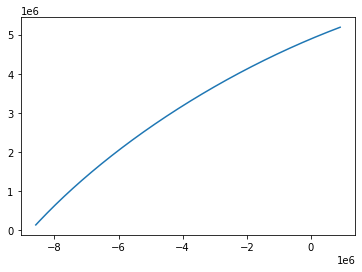

In [14]:
import matplotlib.pyplot as plt
plt.plot(state_series[:,0],state_series[:,1])

In [15]:
## 得到LVLH坐标下 space telescope 对空间目标的观测角

def tele_trans_LVLH(r, v):
    # LVLH
    # o3:LVLH Z-axis - Aligned with the spacecraft geocentric position vector
    # o2:LVLH Y-axis - Aligned with the negative orbit-normal
    # o1:LVLH X-axis - Completes the right-hand triad

    o3 = - r / (np.linalg.norm(r))
    o2 = - np.cross(r, v) / (np.linalg.norm(np.cross(r, v)))
    o1 = np.cross(o2, o3)

    rot = np.vstack((o1.T, o2.T, o3.T))

    return rot


def target_trans_LVLH(r, v, rot, r_t, r_v):
    r_d = r_t - r
    trans_r = np.dot(rot, r_d.T)

    # x,y,z --> sphercial
    z = trans_r[2]
    y = trans_r[1]
    x = trans_r[0]

    R = np.linalg.norm(trans_r)
    theta = np.arccos(z / R)  # [0 - pi]
    phi = np.arctan(y / x)  # [-pi/2, pi/2]

    theta = (theta * 180) / np.pi
    phi = (phi * 180) / np.pi

    if (y > 0) and (x < 0):
        phi += 180
    if (y < 0) and (x < 0):
        phi += 180
    if (y < 0) and (x > 0):
        phi += 360

    return R, theta, phi

## 测试20组仿真数据的观测情况

In [16]:
name = []
for i in range(0,20):
    name.append(str(i))

dic = {}
for i in name:
    dic[i] = []

[5412518.599835215]
list is not none


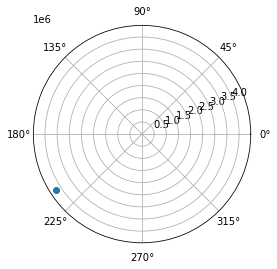

[5397567.272454046]
list is not none


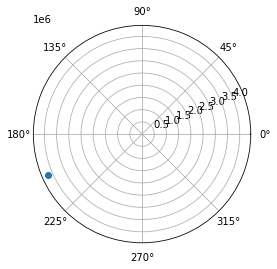

[5382690.385689813]
list is not none


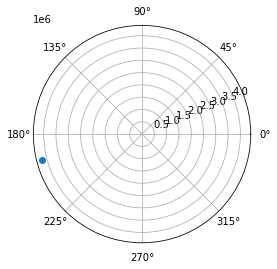

[5367888.705209378]
list is not none


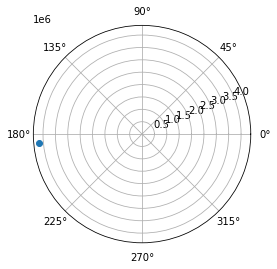

[5353163.000770267]
list is not none


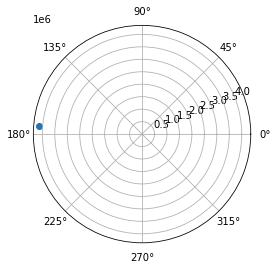

[5338514.046166824]
list is not none


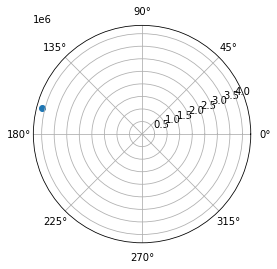

[5323942.619173527]
list is not none


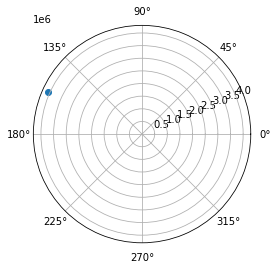

[5309449.50148535]
list is not none


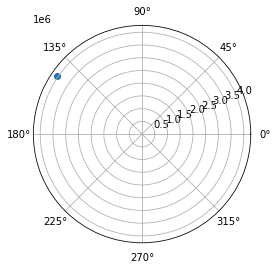

[5295035.478655178]
list is not none


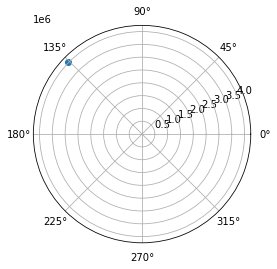

[5280701.340028139]
list is not none


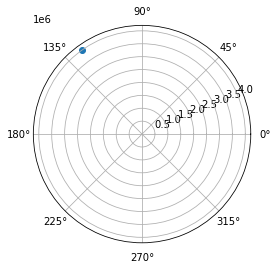

[5266447.878672863]
list is not none


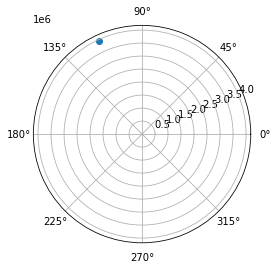

[5252275.891309592]
list is not none


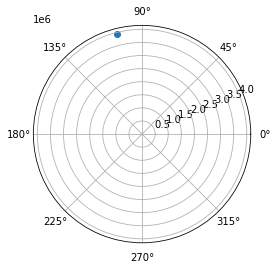

[5238186.178235037]
list is not none


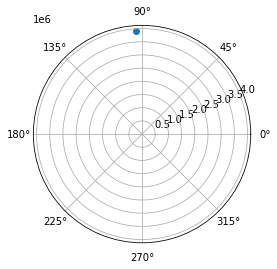

[5224179.543244012]
list is not none


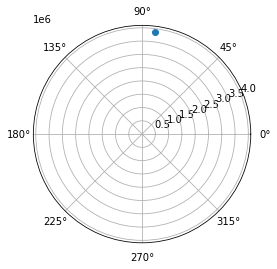

[5210256.793547714]
list is not none


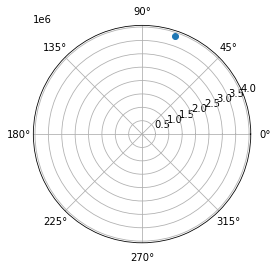

[5196418.739688617]
list is not none


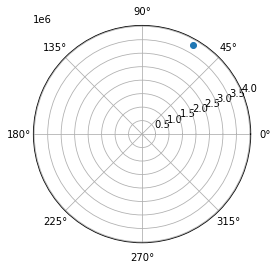

[5182666.195451962]
list is not none


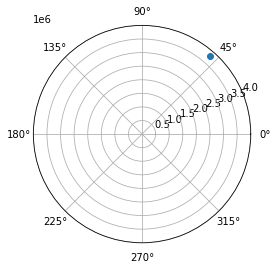

[5168999.977773738]
list is not none


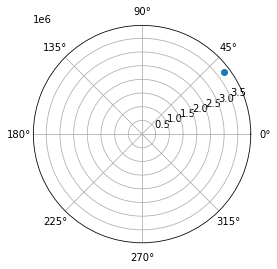

[5155420.906645138]
list is not none


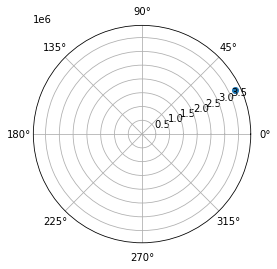

[5141929.805013405]
list is not none


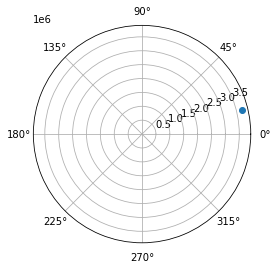

[5128527.498679072]
list is not none


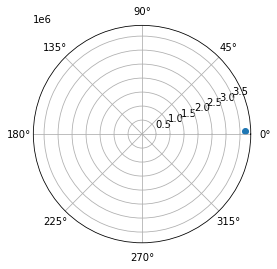

[5115214.8161895145]
list is not none


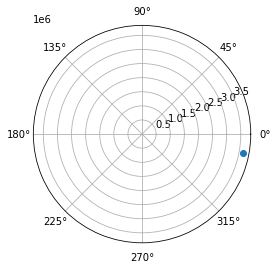

[5101992.5887287455]
list is not none


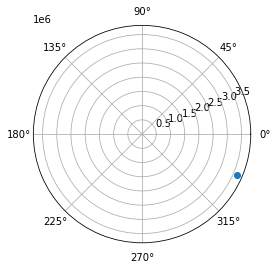

[5088861.650003487]
list is not none


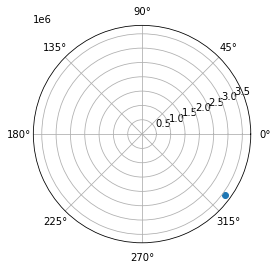

[5075822.836125382]
list is not none


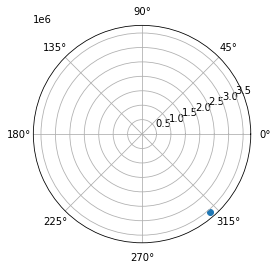

[5062876.985489387]
list is not none


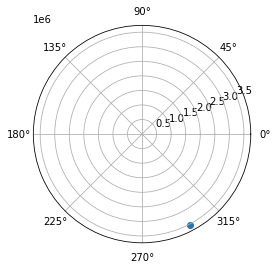

[5050024.938648257]
list is not none


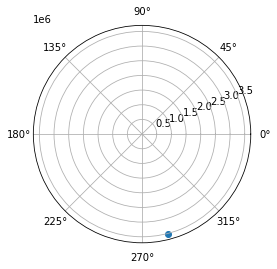

[5039941.711538187]
list is not none


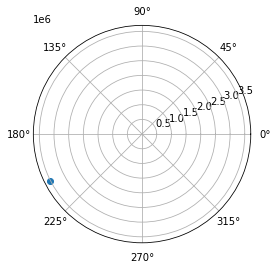

[5052646.307236757]
list is not none


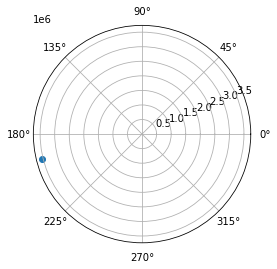

[5065443.521806104]
list is not none


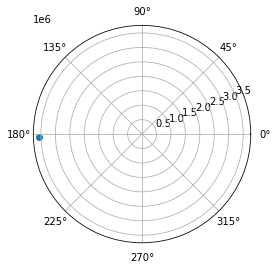

[5078332.509250952]
list is not none


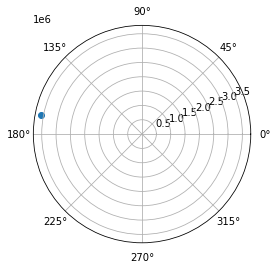

[5091312.425842037]
list is not none


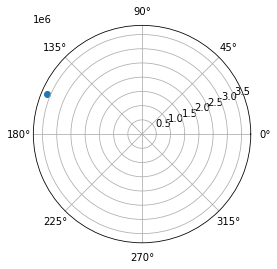

[5104382.430240007]
list is not none


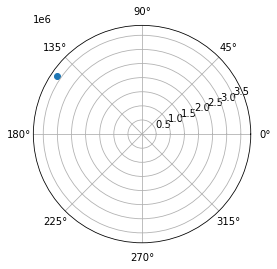

[5117541.68361543]
list is not none


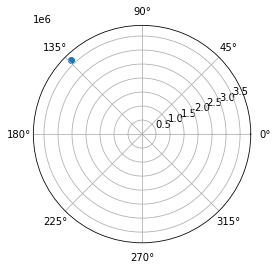

[5130789.34976497]
list is not none


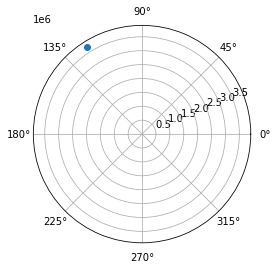

[5144124.595223718]
list is not none


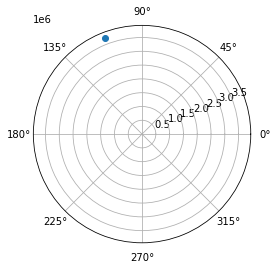

[5157546.589373804]
list is not none


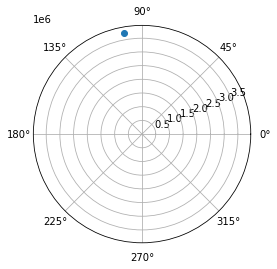

[5171054.504549231]
list is not none


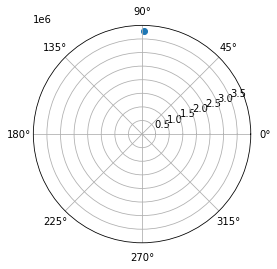

[5184647.51613708]
list is not none


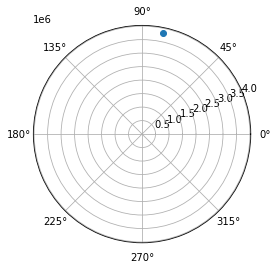

[5198324.802675064]
list is not none


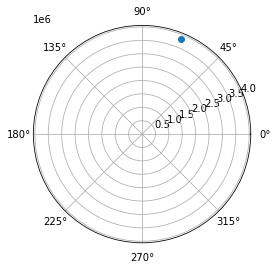

[5212085.545945493]
list is not none


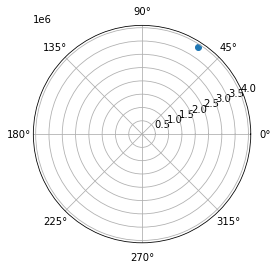

[5225928.931065737]
list is not none


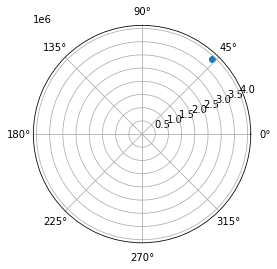

[5239854.146575189]
list is not none


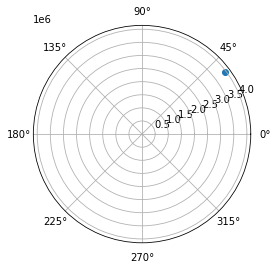

[5253860.384518815]
list is not none


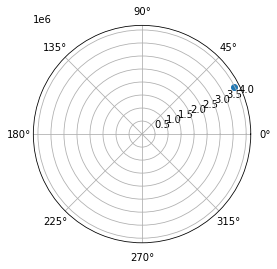

[5267946.840527331]
list is not none


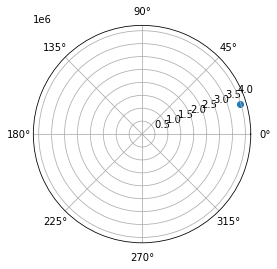

[5282112.713894078]
list is not none


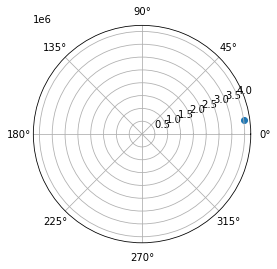

[5296357.207648608]
list is not none


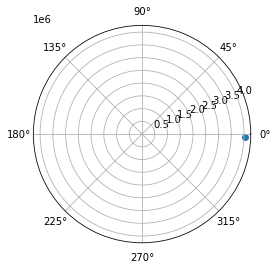

[5310679.528627107]
list is not none


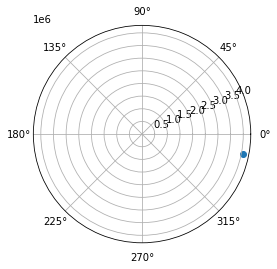

[5325078.887539657]
list is not none


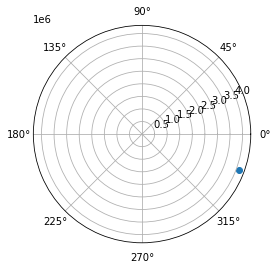

[5339554.4990344]
list is not none


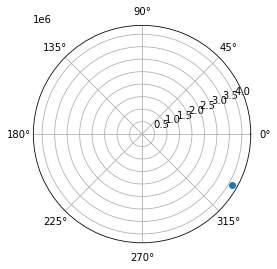

[5354105.58175869]
list is not none


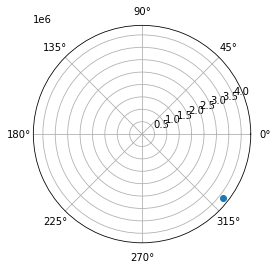

[5368731.358417283]
list is not none


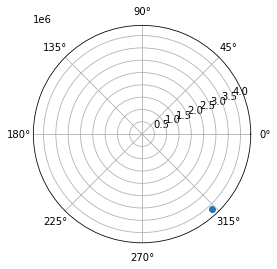

[5383431.055827592]
list is not none


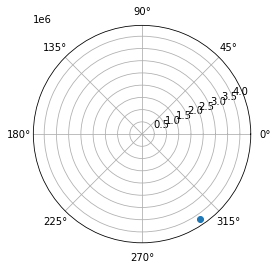

[5398203.904972114]
list is not none


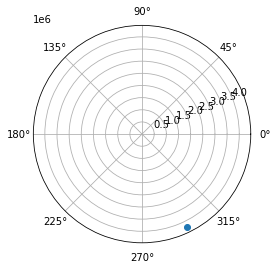

[5655849.4967036415]
list is not none


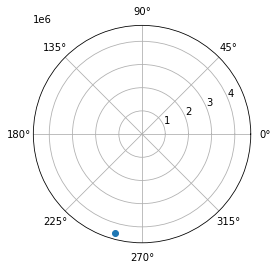

[5645357.025443358]
list is not none


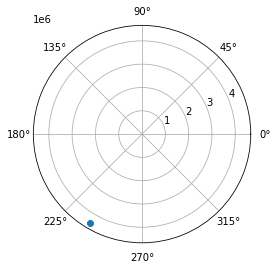

[5634939.5920921]
list is not none


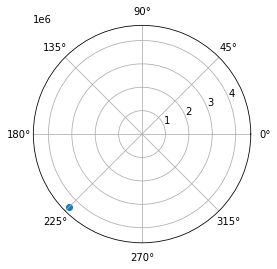

[5624597.741239111]
list is not none


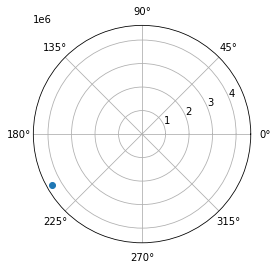

[5614332.017487505]
list is not none


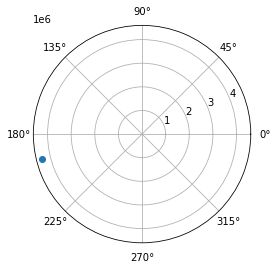

[5604142.965379234]
list is not none


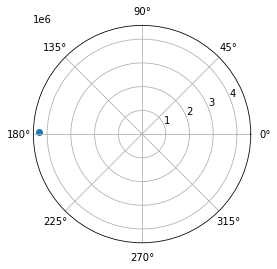

[5594031.129318717]
list is not none


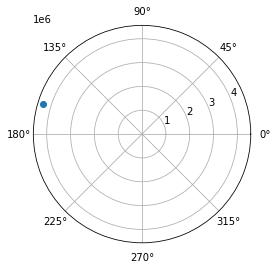

[5583997.0534951575]
list is not none


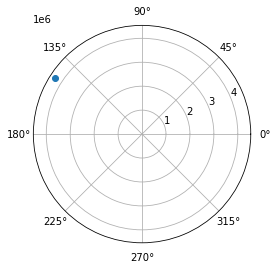

[5574041.28180351]
list is not none


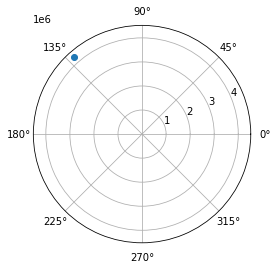

[5564164.357764151]
list is not none


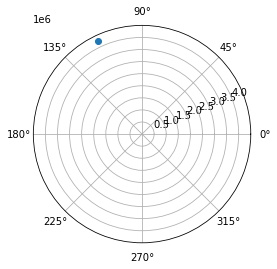

[5554366.824441219]
list is not none


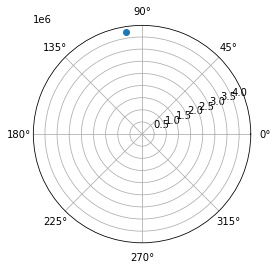

[5544649.224359683]
list is not none


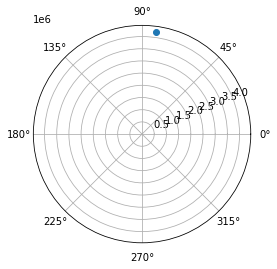

[5535012.0994210895]
list is not none


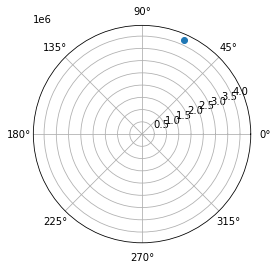

[5525455.990818046]
list is not none


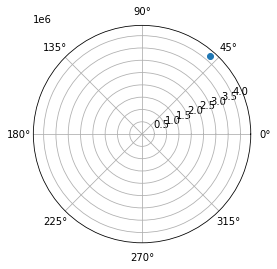

[5515981.43894744]
list is not none


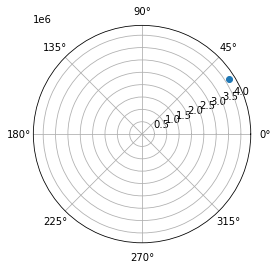

[5506588.983322403]
list is not none


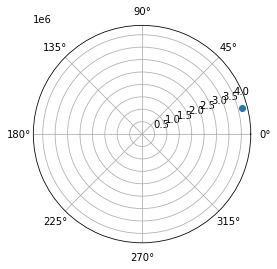

[5497279.162483042]
list is not none


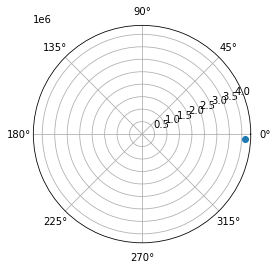

[5488052.513905932]
list is not none


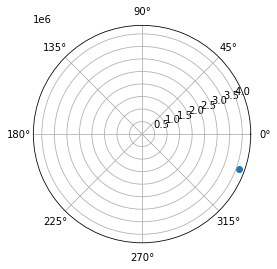

[5478909.573912428]
list is not none


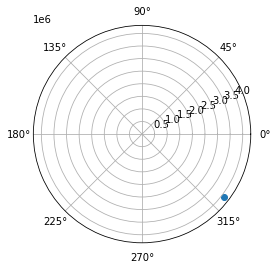

[5469850.877575788]
list is not none


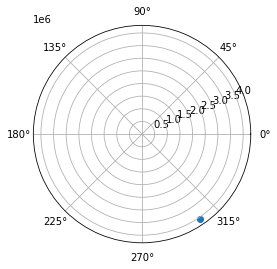

[5460876.958627109]
list is not none


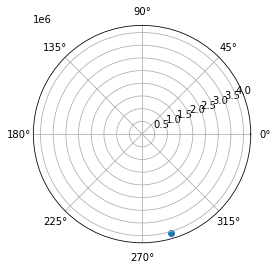

[5451988.349360155]
list is not none


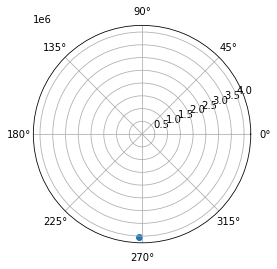

[5443185.580535027]
list is not none


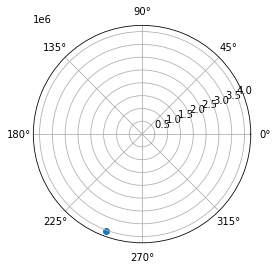

[5434469.18128077]
list is not none


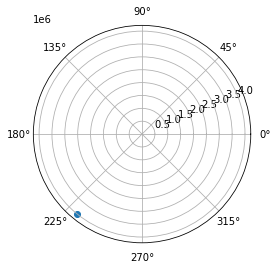

[5425839.678996876]
list is not none


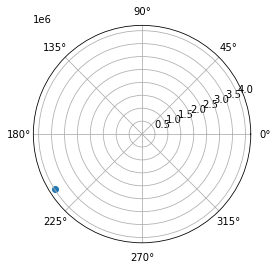

[5417297.59925377]
list is not none


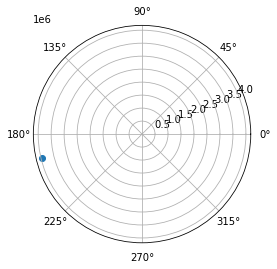

[5408843.465692256]
list is not none


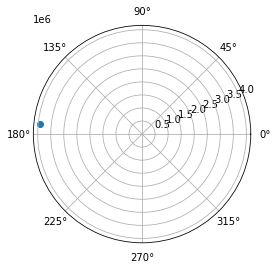

[5400477.799921981]
list is not none


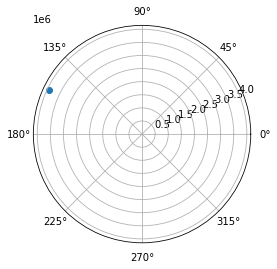

[5392201.121418946]
list is not none


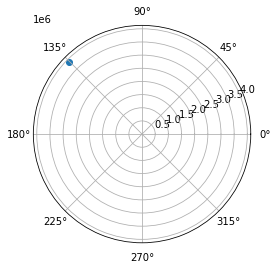

[5384013.947422092]
list is not none


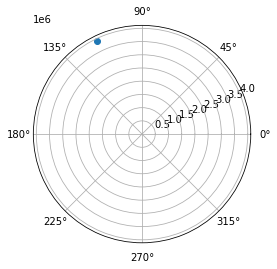

[5375916.7928289715]
list is not none


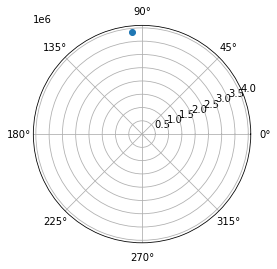

[5367910.17009059]
list is not none


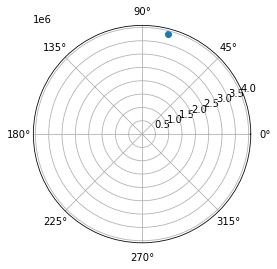

[5359994.5891054]
list is not none


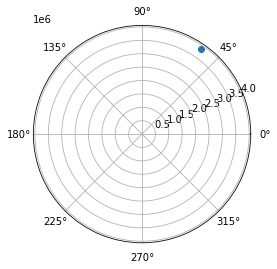

[5352170.557112533]
list is not none


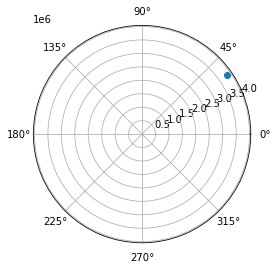

[5344438.57858425]
list is not none


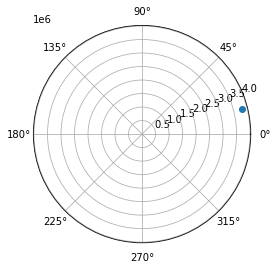

[5336799.15511773]
list is not none


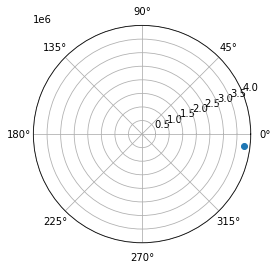

[5329252.785326143]
list is not none


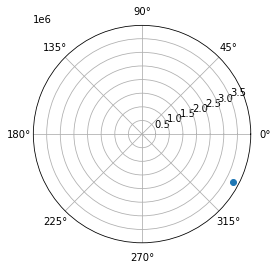

[5321799.964729147]
list is not none


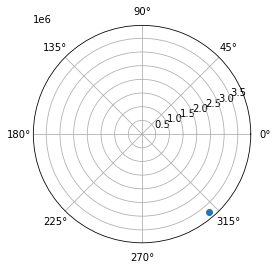

[5314441.185642764]
list is not none


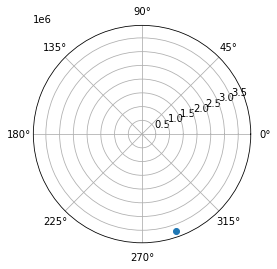

[5307176.937068746]
list is not none


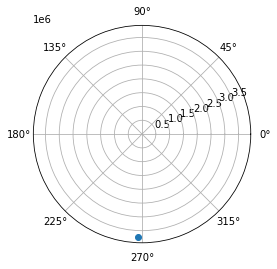

[5300007.704583452]
list is not none


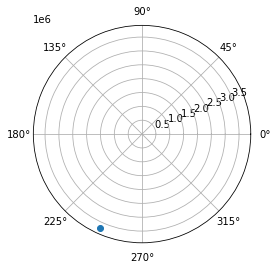

[5292933.970226266]
list is not none


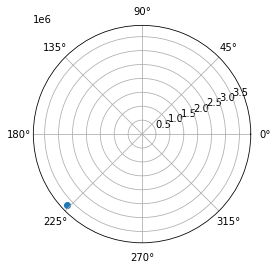

[5285956.212387648]
list is not none


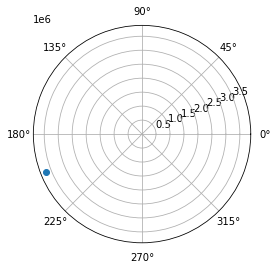

[5279074.905696833]
list is not none


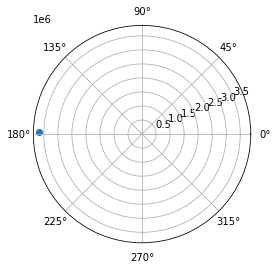

[5263481.180293623]
list is not none


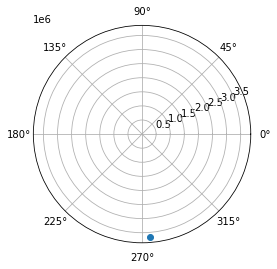

[5270194.540074664]
list is not none


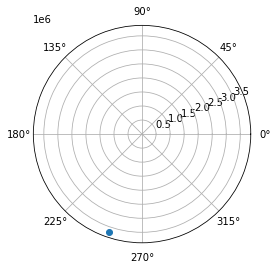

[5277008.095954353]
list is not none


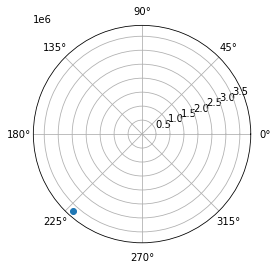

[5283921.413376586]
list is not none


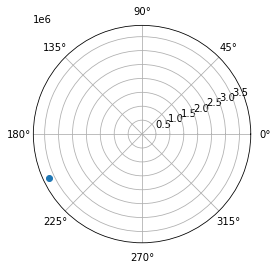

[5290934.053284957]
list is not none


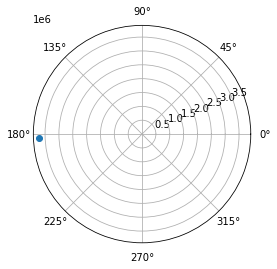

[5298045.57223507]
list is not none


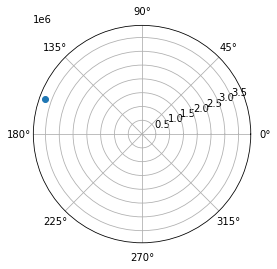

[5305255.522506854]
list is not none


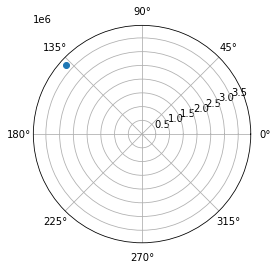

[5312563.45221679]
list is not none


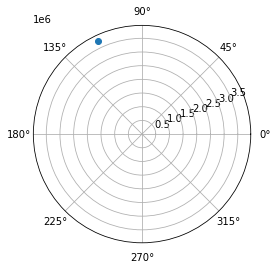

[5319968.905430056]
list is not none


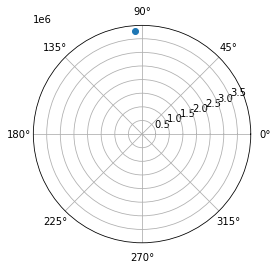

[5327471.422272468]
list is not none


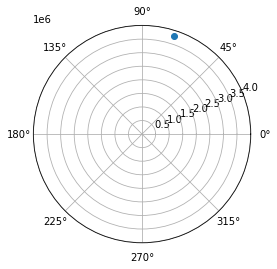

[5335070.539042197]
list is not none


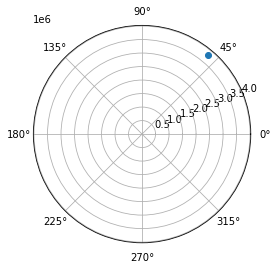

[5342765.78832124]
list is not none


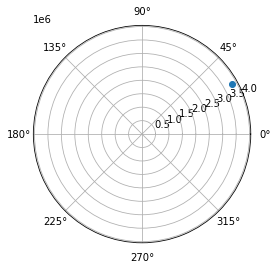

[5350556.699086502]
list is not none


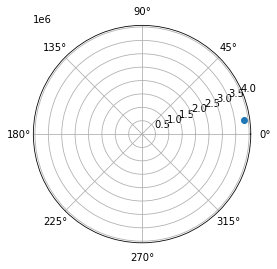

[5358442.796820565]
list is not none


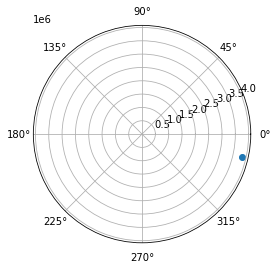

[5366423.603621957]
list is not none


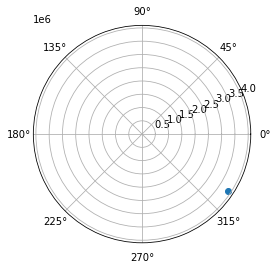

[5374498.638315014]
list is not none


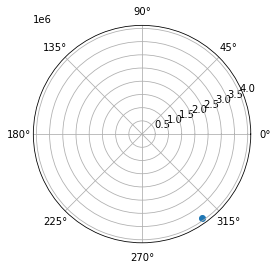

[5382667.416559174]
list is not none


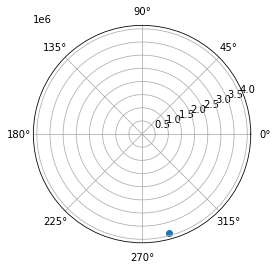

[5390929.450957712]
list is not none


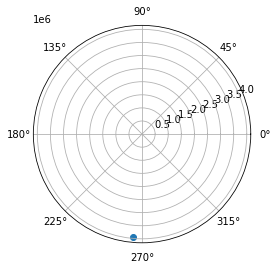

[5399284.251165876]
list is not none


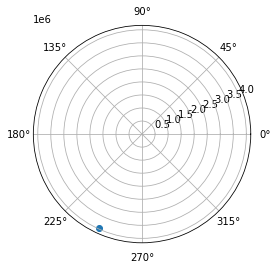

[5407731.323998371]
list is not none


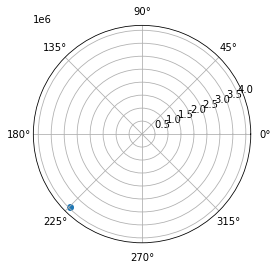

[5416270.173536118]
list is not none


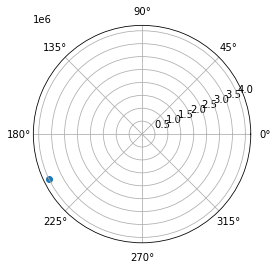

[5424900.301232334]
list is not none


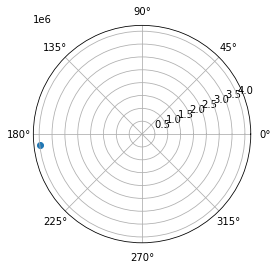

[5433621.206017782]
list is not none


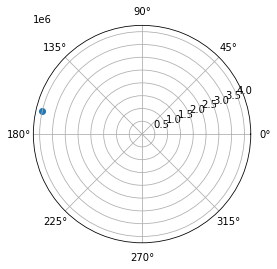

[5442432.38440525]
list is not none


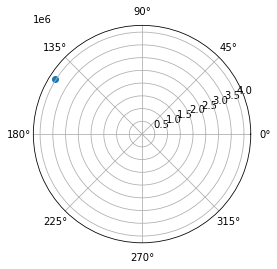

[5451333.330593172]
list is not none


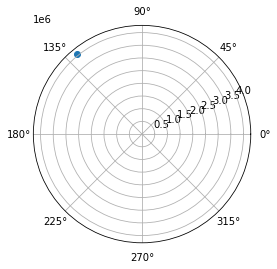

[5460323.536568375]
list is not none


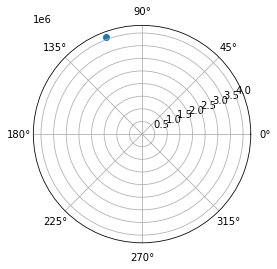

[5469402.492207906]
list is not none


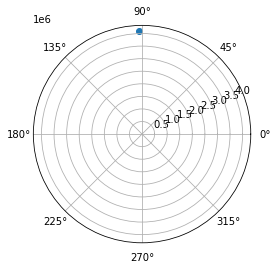

[5478569.685379928]
list is not none


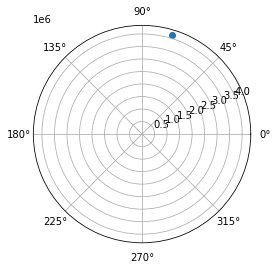

[5487824.602043629]
list is not none


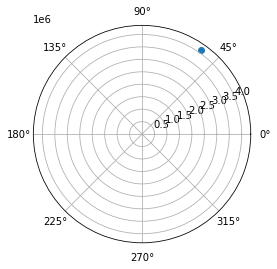

[5497166.7263481375]
list is not none


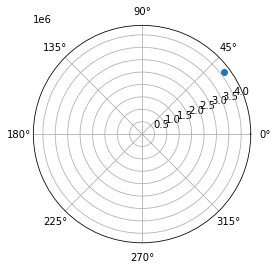

[5506595.540730404, 5750059.500211883]
list is not none


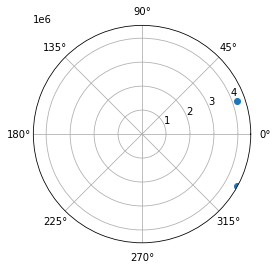

[5516110.526012028, 5742068.260803347]
list is not none


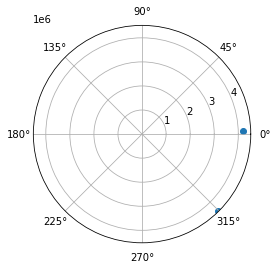

[5525711.161495005, 5734154.735683493]
list is not none


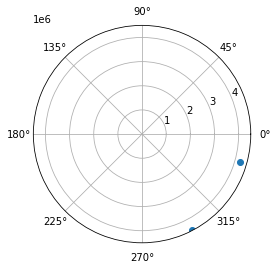

[5535396.925056361, 5726319.358754124]
list is not none


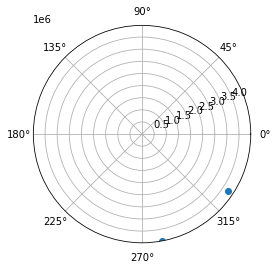

[5545167.293241669, 5718562.562214445]
list is not none


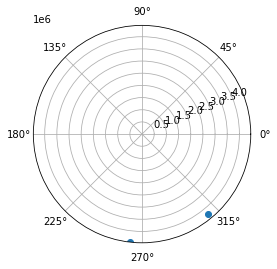

[5555021.741357415, 5710884.776488875]
list is not none


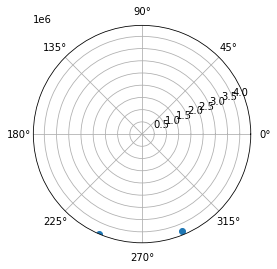

[5564959.743562184, 5703286.430154339]
list is not none


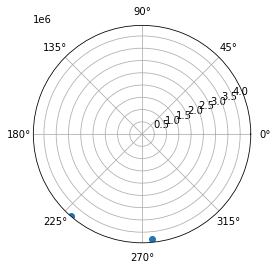

[5574980.772956683, 5695767.9498670185]
list is not none


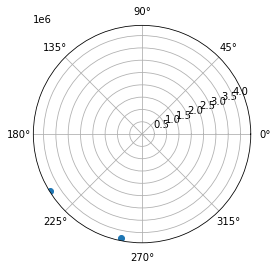

[5585084.301672532, 5688329.760288604]
list is not none


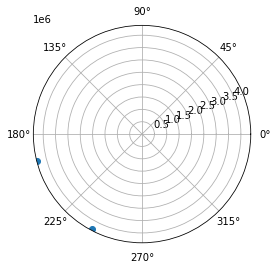

[5595269.800959858, 5680972.28401209]
list is not none


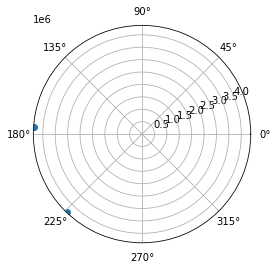

[5605536.741273633, 5673695.941487098]
list is not none


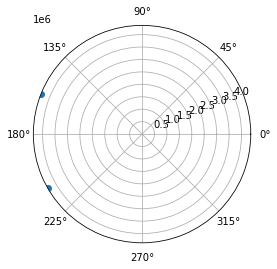

[5615884.592358787, 5666501.15094477]
list is not none


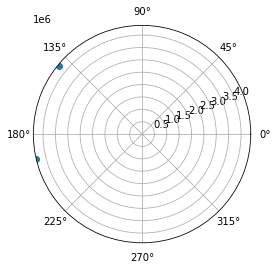

[5626312.823334039, 5659388.328322266]
list is not none


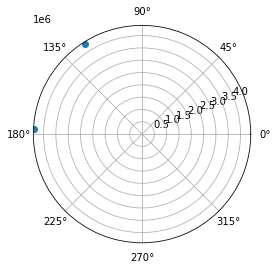

[5636820.902774459, 5652357.887186861]
list is not none


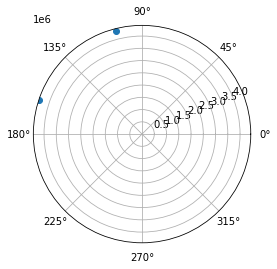

[5645410.238659709]
list is not none


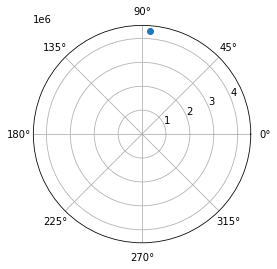

[5638545.791339271]
list is not none


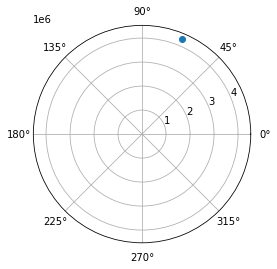

[5631764.951224424]
list is not none


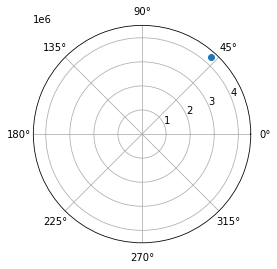

[5625068.121637322]
list is not none


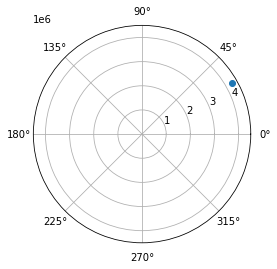

[5618455.703145986]
list is not none


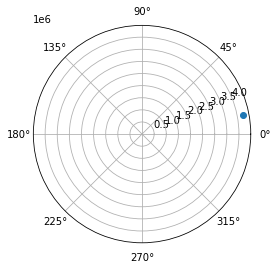

[5611928.093486703]
list is not none


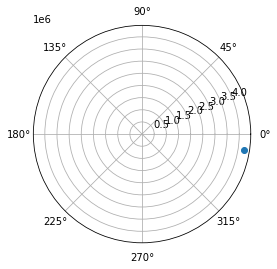

[5605485.687486208]
list is not none


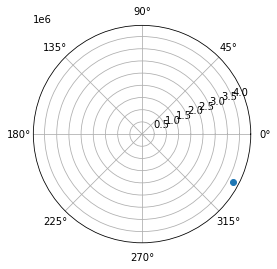

[5599128.876983741]
list is not none


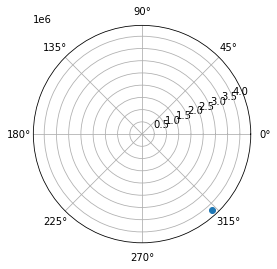

[5592858.050752939]
list is not none


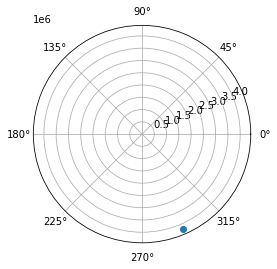

[5586673.594423683]
list is not none


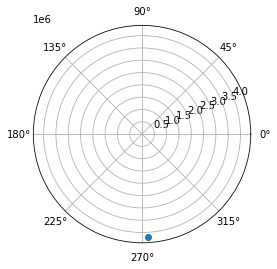

[5580575.890403836]
list is not none


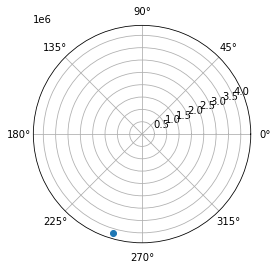

[5574565.3178009745]
list is not none


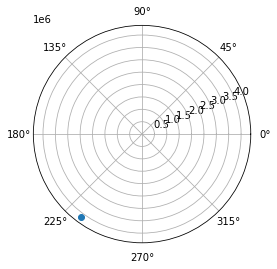

[5568642.252344116]
list is not none


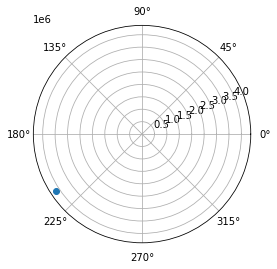

[5562807.066305499]
list is not none


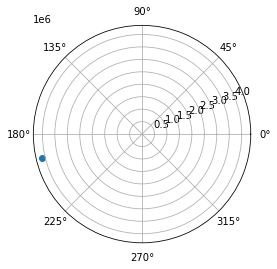

[5557060.1284224]
list is not none


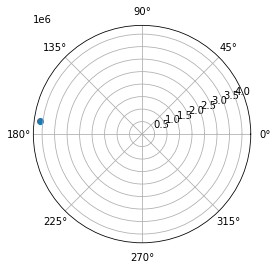

[5551401.803819106]
list is not none


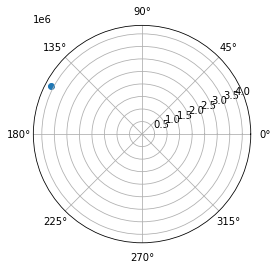

[5545832.453928967]
list is not none


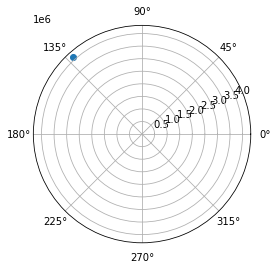

[5540352.436416675]
list is not none


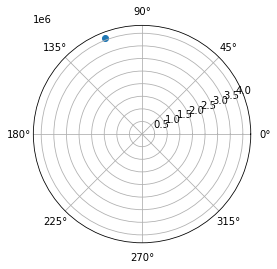

[5534962.105100741]
list is not none


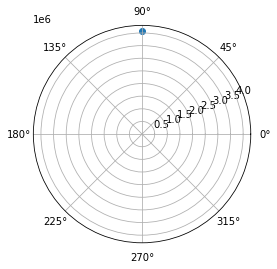

[5529661.809876209]
list is not none


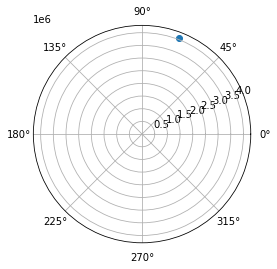

[5524451.896637668]
list is not none


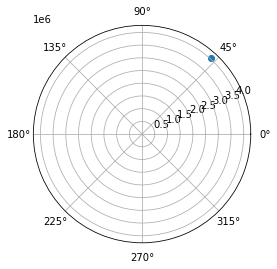

[5519332.707202581]
list is not none


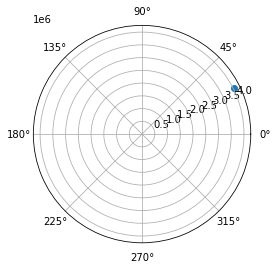

[5514304.579234972]
list is not none


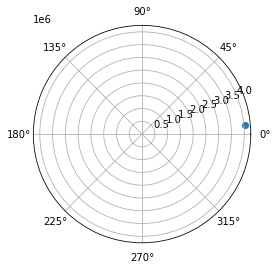

[5509367.846169527]
list is not none


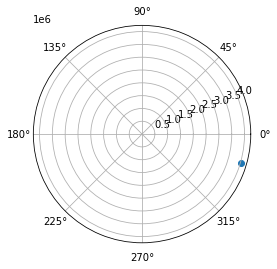

[5504522.837136098]
list is not none


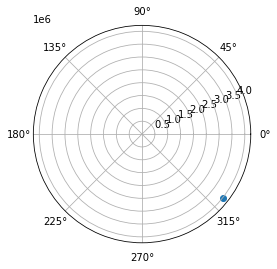

[5499769.876884716]
list is not none


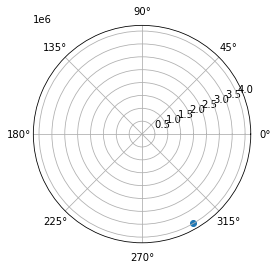

[5495109.285711099]
list is not none


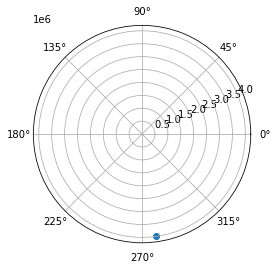

[5490541.379382704]
list is not none


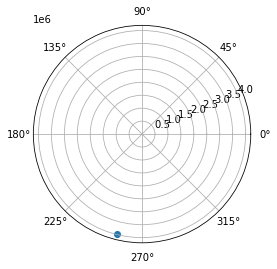

[5486066.469065388]
list is not none


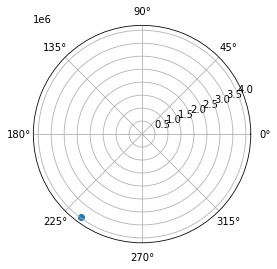

[5481684.861250662]
list is not none


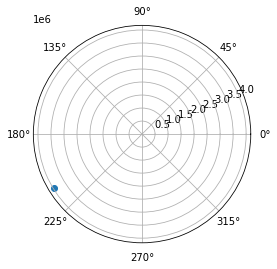

[5477396.857683671]
list is not none


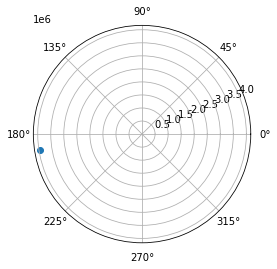

[5473202.75529181]
list is not none


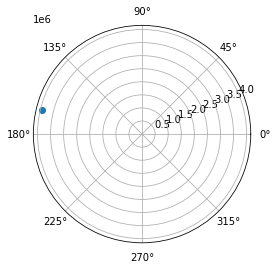

[5469102.846114132]
list is not none


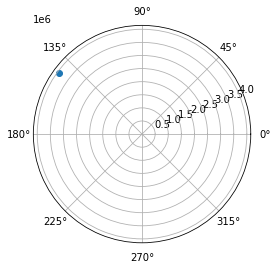

[5465097.417231528]
list is not none


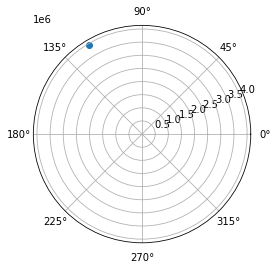

[5461186.750697714]
list is not none


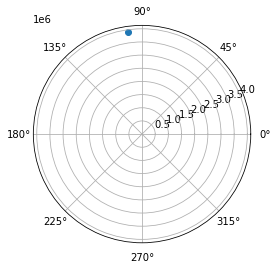

[5457371.123471103]
list is not none


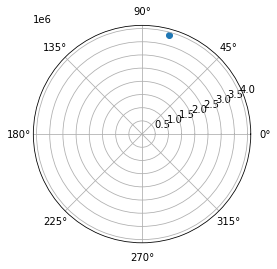

[5453650.807347542]
list is not none


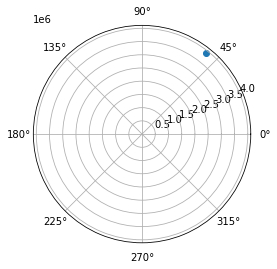

[5450026.068894028]
list is not none


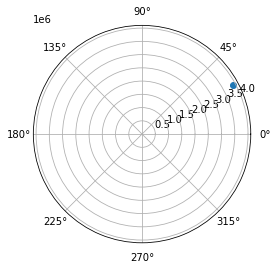

[5446497.169383366]
list is not none


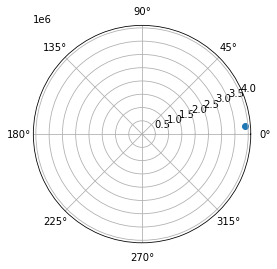

[5443064.364729848]
list is not none


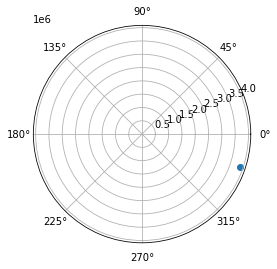

[5439727.905425989]
list is not none


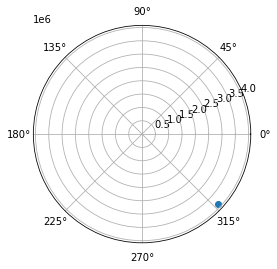

[5436488.036480349]
list is not none


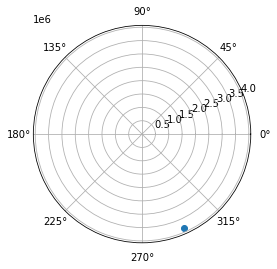

[5433344.997356467]
list is not none


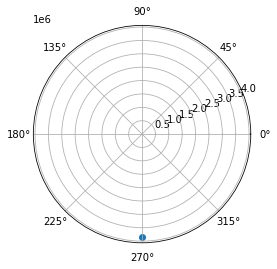

[5430299.021912971]
list is not none


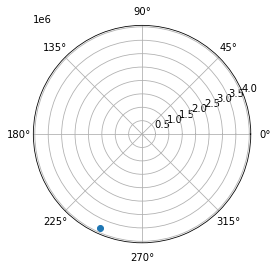

[5427350.338344875]
list is not none


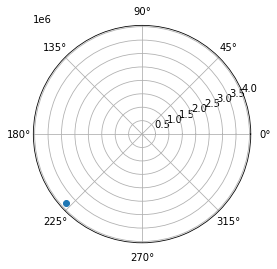

[5424499.169126108]
list is not none


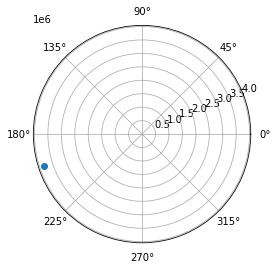

[5421745.730953316]
list is not none


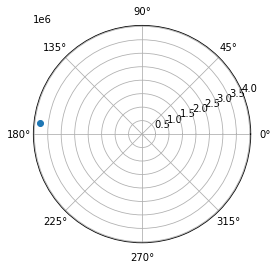

[5419090.234690954]
list is not none


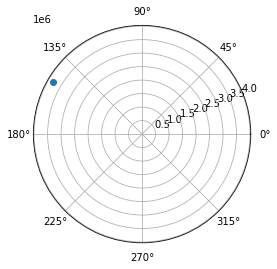

[5416532.8853177205]
list is not none


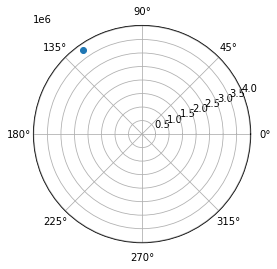

[5414073.881874363]
list is not none


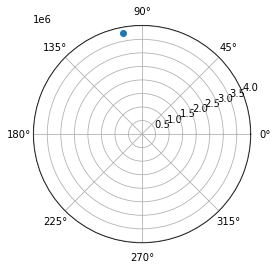

[5411713.417412862]
list is not none


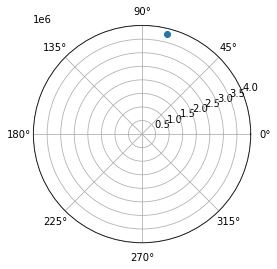

[5409451.67894708]
list is not none


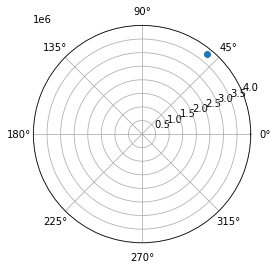

[5407288.847404846]
list is not none


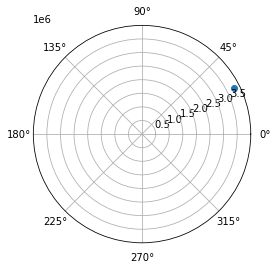

[5405225.097581537]
list is not none


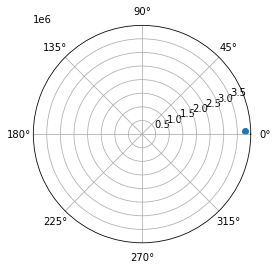

[5403260.598095204]
list is not none


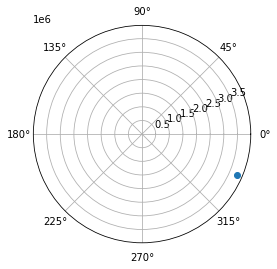

[5401395.511343205]
list is not none


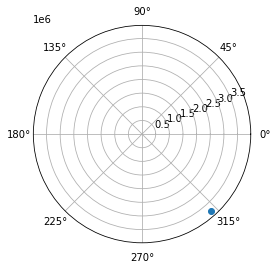

[5399629.99346047]
list is not none


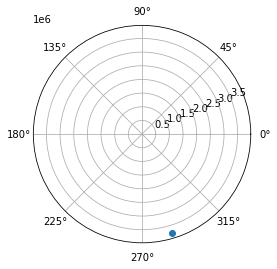

[5397964.194279319]
list is not none


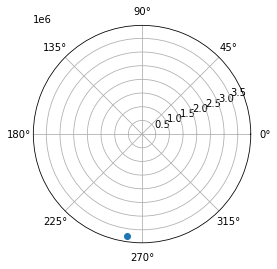

[5396398.257290949]
list is not none


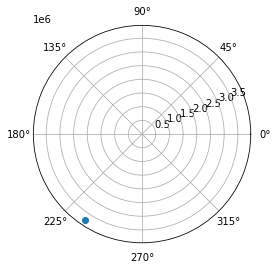

[5394932.319608558]
list is not none


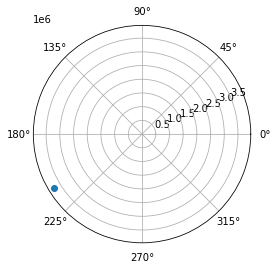

[5393566.511932155]
list is not none


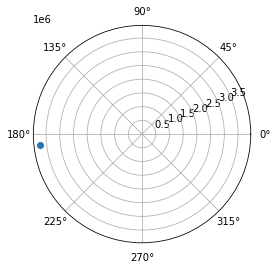

[5392300.958515065]
list is not none


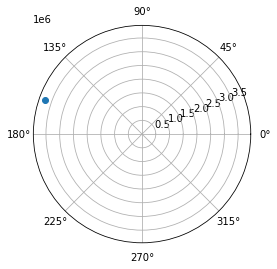

[5391135.777132164]
list is not none


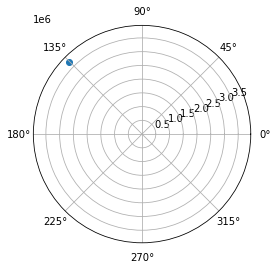

[5390071.079049863]
list is not none


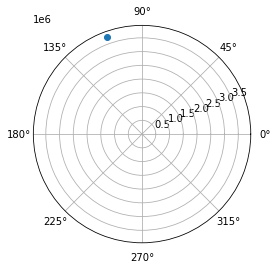

[5389106.9689978445]
list is not none


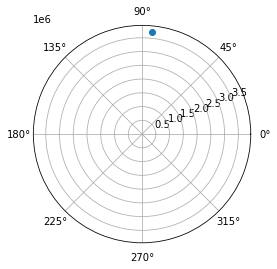

[5388243.545142591]
list is not none


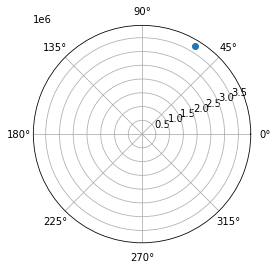

[5387480.899062709]
list is not none


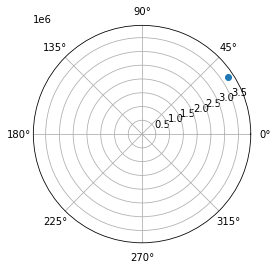

[5386819.115726068]
list is not none


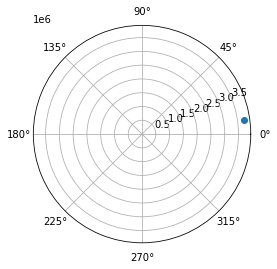

[5386258.273468779]
list is not none


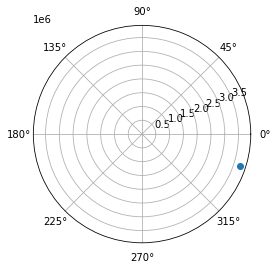

[5389991.372296293]
list is not none


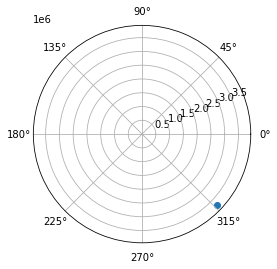

[5391050.776986405]
list is not none


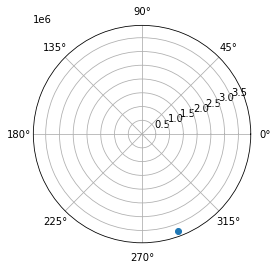

[5392211.428517228]
list is not none


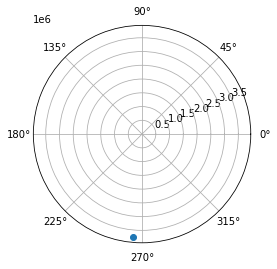

[5393473.284401481]
list is not none


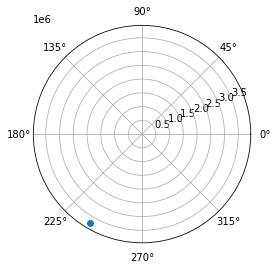

[5394836.295479218]
list is not none


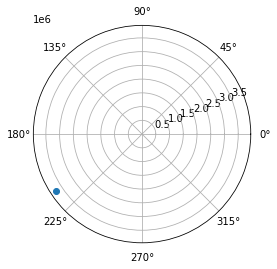

[5396300.405934627]
list is not none


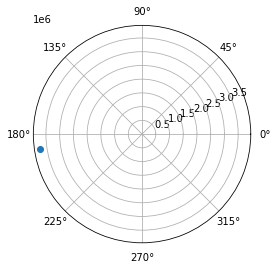

[5397865.55331468]
list is not none


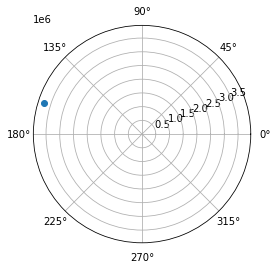

[5399531.66854961]
list is not none


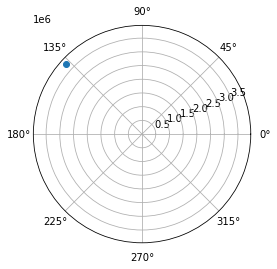

[5401298.675975225]
list is not none


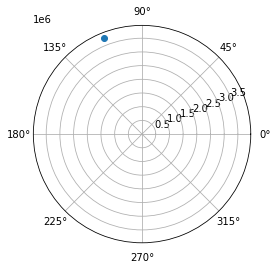

[5403166.493357037]
list is not none


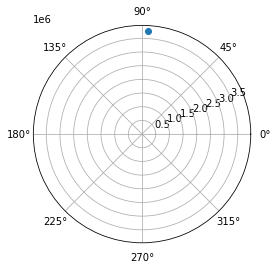

[5405135.031916156]
list is not none


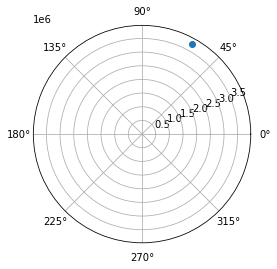

[5407204.196356996]
list is not none


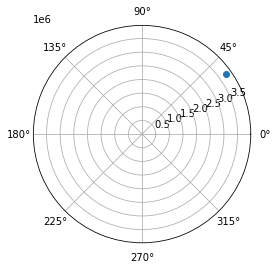

[5409373.884896711]
list is not none


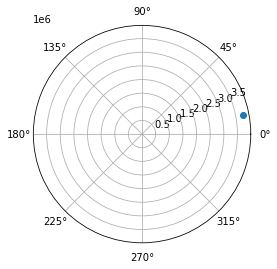

[5411643.9892963795]
list is not none


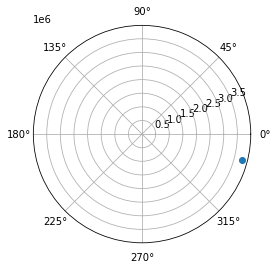

[5414014.394893894]
list is not none


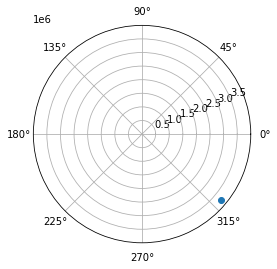

[5416484.980638559]
list is not none


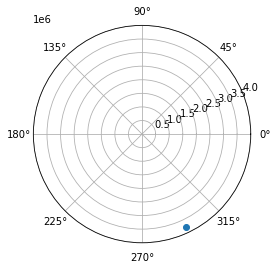

[5419055.619127348]
list is not none


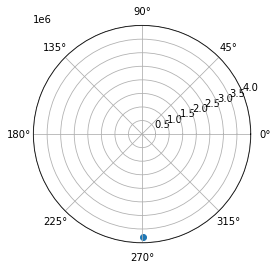

[5421726.1766428035]
list is not none


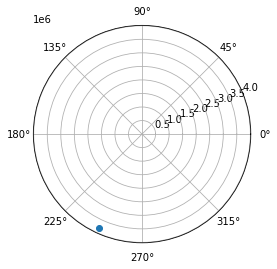

[5424496.513192571]
list is not none


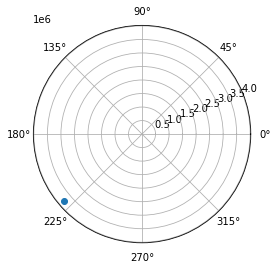

[5427366.482550516]
list is not none


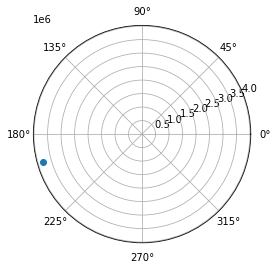

[5430335.932299408]
list is not none


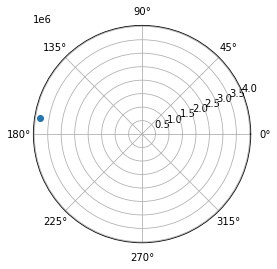

[5433404.703875159]
list is not none


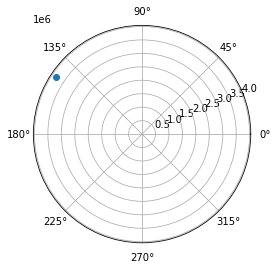

[5436572.632612551]
list is not none


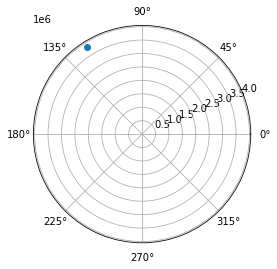

[5439839.5477924645]
list is not none


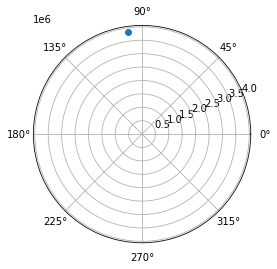

[5443205.272690551]
list is not none


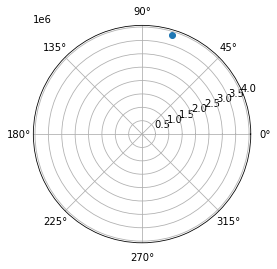

[5446669.624627314]
list is not none


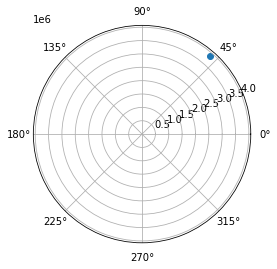

[5450232.4150196]
list is not none


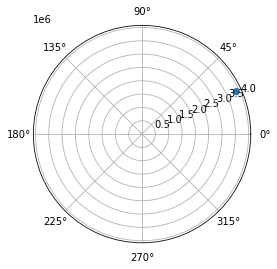

[5453893.449433425]
list is not none


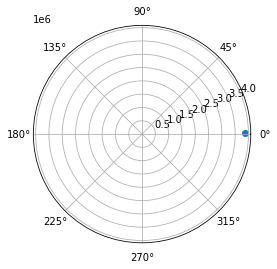

[5457652.527638141]
list is not none


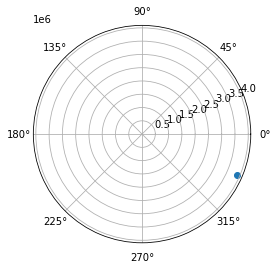

[5461509.443661872]
list is not none


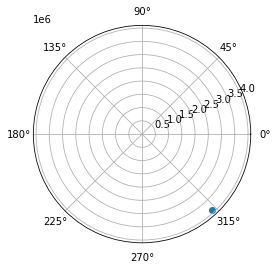

[5465463.985848221]
list is not none


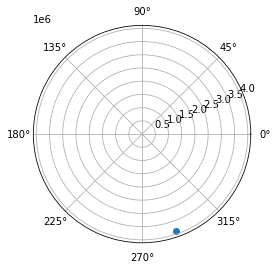

[5469515.93691419]
list is not none


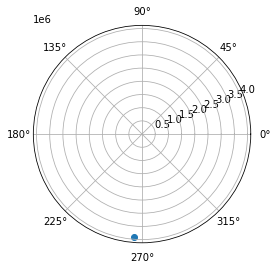

[5473665.074009278]
list is not none


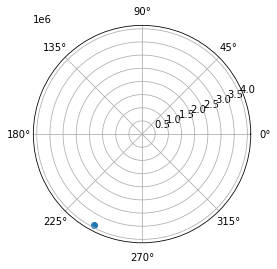

[5477911.168775741]
list is not none


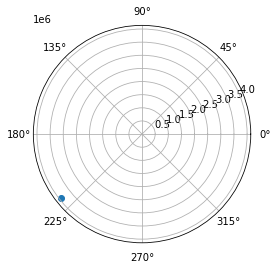

[5482253.987409949]
list is not none


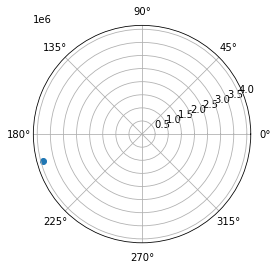

[5486693.290724827]
list is not none


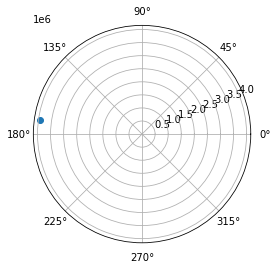

[5491228.834213339]
list is not none


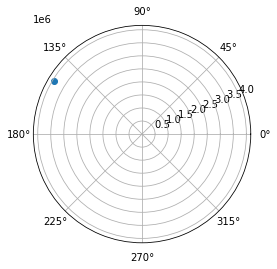

[5495860.368112954]
list is not none


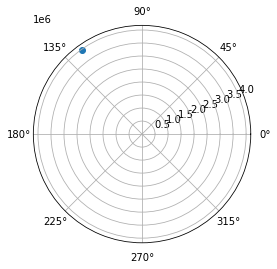

[5500587.637471098]
list is not none


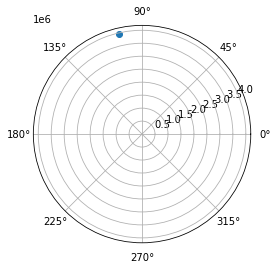

[5505410.382211512]
list is not none


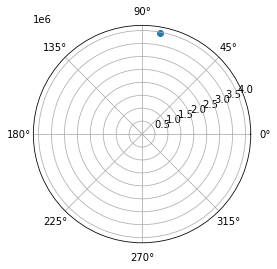

[5510328.337201517]
list is not none


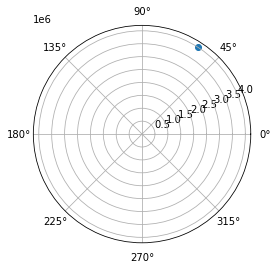

[5515341.232320107]
list is not none


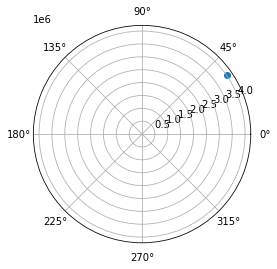

[5520448.792526874]
list is not none


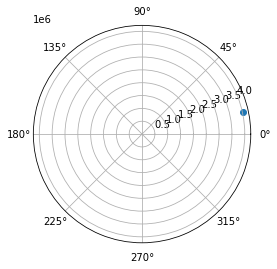

[5525650.737931681]
list is not none


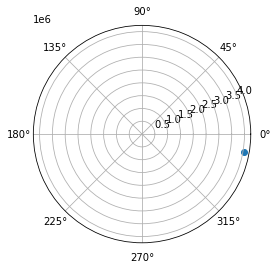

[5530946.783865096]
list is not none


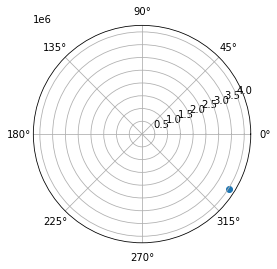

[5536336.640949506]
list is not none


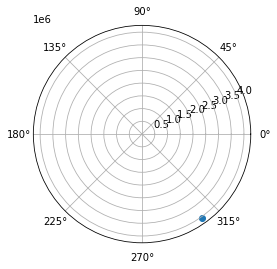

[5541820.015170876]
list is not none


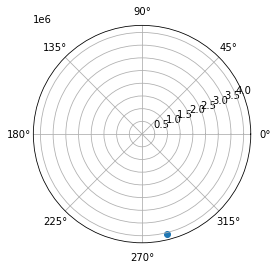

[5547396.607951161]
list is not none


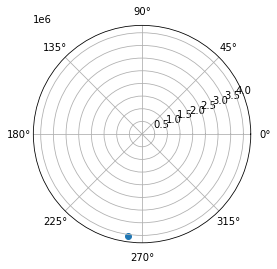

[5553066.116221265]
list is not none


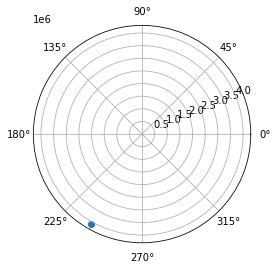

[5558828.232494557]
list is not none


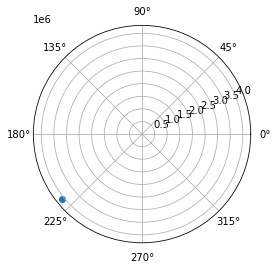

[5564682.644940889]
list is not none


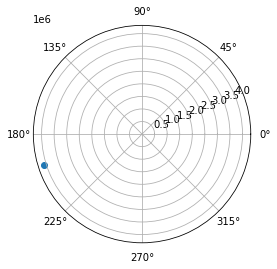

[5570629.0374610815]
list is not none


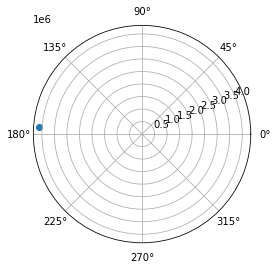

[5576667.089761829]
list is not none


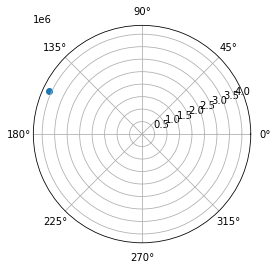

[5582796.477431006]
list is not none


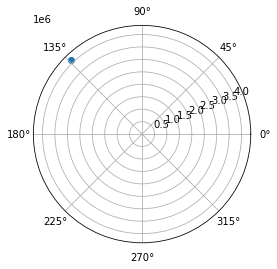

[5589016.872013317]
list is not none


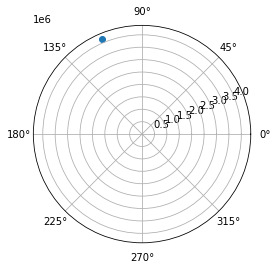

[5595327.941086279]
list is not none


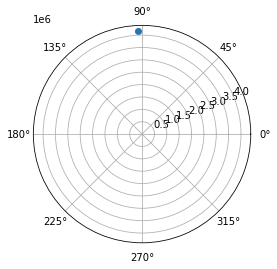

[5601729.34833646]
list is not none


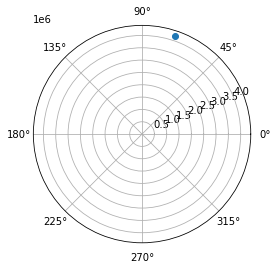

[5608220.753635978]
list is not none


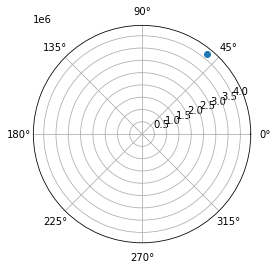

[5614801.813119209]
list is not none


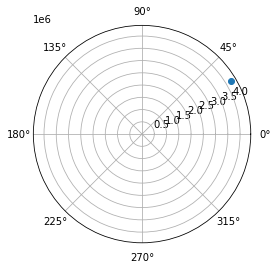

[5621472.179259653]
list is not none


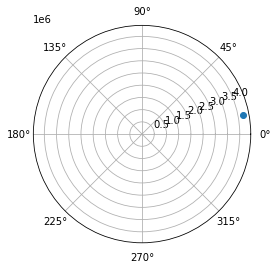

[5628231.500946952]
list is not none


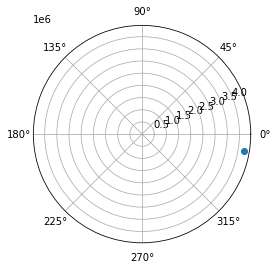

[5635079.423563999]
list is not none


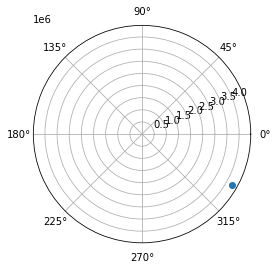

[5642015.589064127]
list is not none


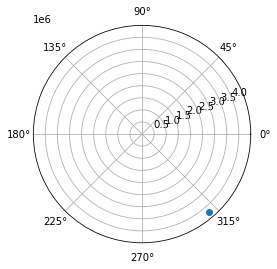

[5649039.636048315]
list is not none


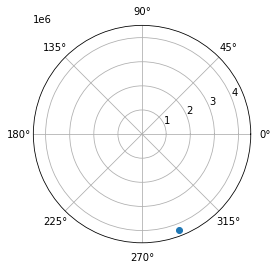

[5656151.199842422]
list is not none


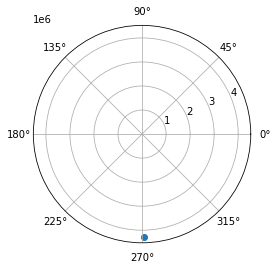

[5663349.912574357]
list is not none


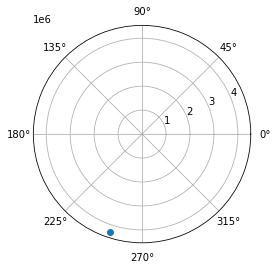

[5670635.403251215]
list is not none


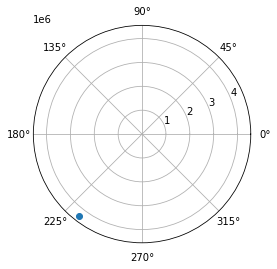

[5678007.297836308]
list is not none


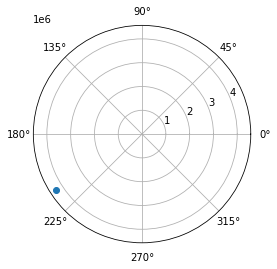

[5685465.219326051]
list is not none


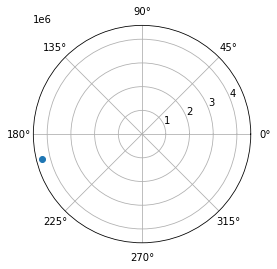

[5693008.787826735]
list is not none


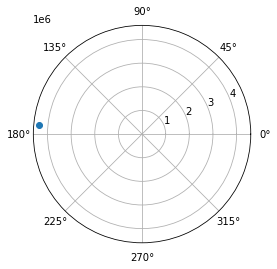

[5700637.6206310615]
list is not none


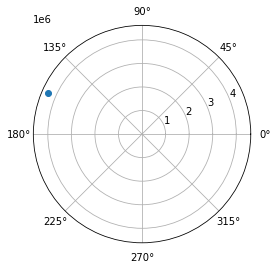

[5708351.332294517]
list is not none


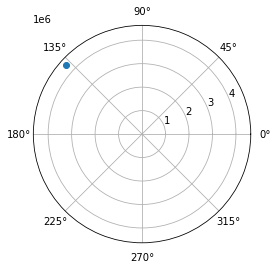

[5716149.534711451]
list is not none


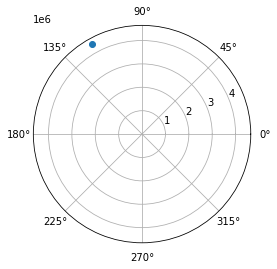

[5724031.837190923]
list is not none


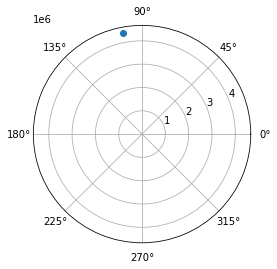

[5731997.846532228]
list is not none


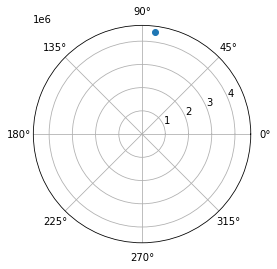

[5740047.167100111]
list is not none


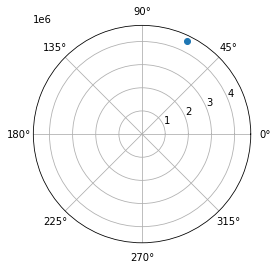

[5748179.40089962]
list is not none


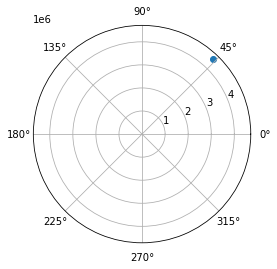

[5756394.147650589]
list is not none


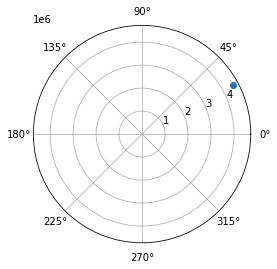

[5764691.004861722]
list is not none


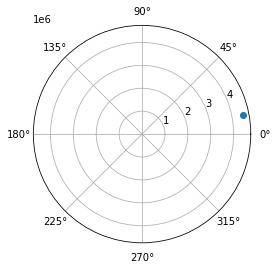

[5773069.5679042395]
list is not none


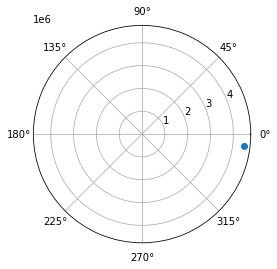

[5781529.4300851]
list is not none


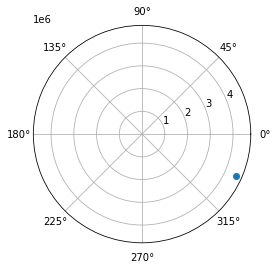

[5790070.182719729]
list is not none


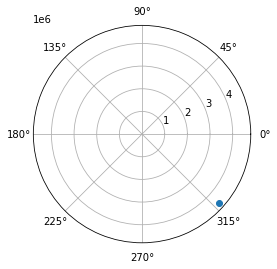

[5798691.41520427]
list is not none


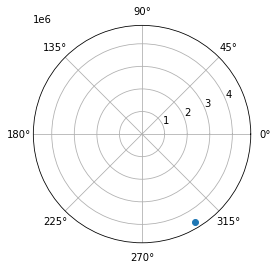

[4606594.97467054]
list is not none


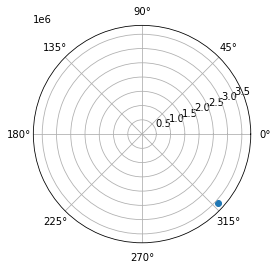

[4593209.194891808]
list is not none


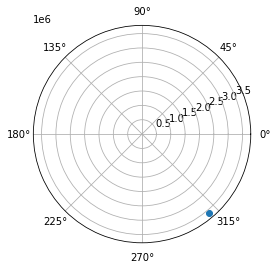

[4579882.890970245]
list is not none


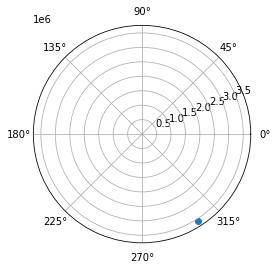

[4566616.739360953]
list is not none


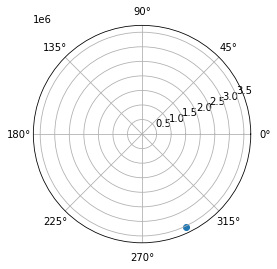

[4553411.420953612]
list is not none


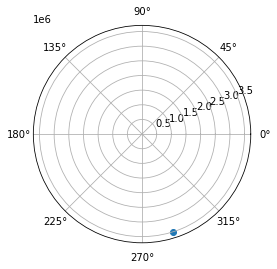

[4540267.621044701]
list is not none


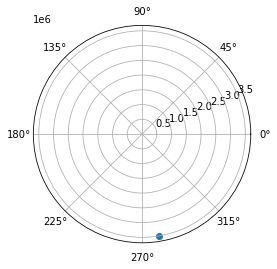

[4527186.029307381]
list is not none


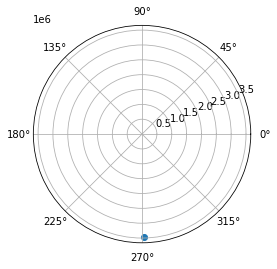

[4514167.339758871]
list is not none


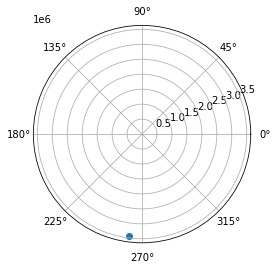

[4501212.250725342]
list is not none


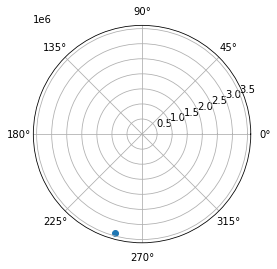

[4488321.464804199]
list is not none


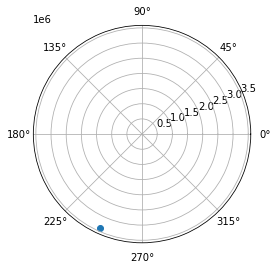

[4475495.68882372]
list is not none


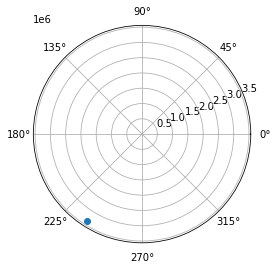

[4462735.633799997]
list is not none


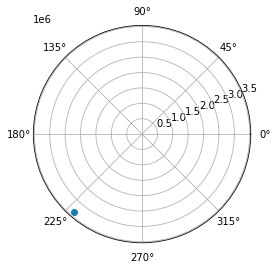

[4450042.014891061]
list is not none


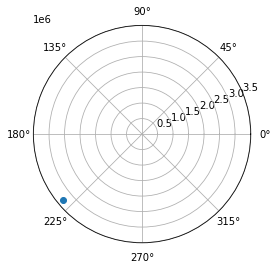

[4437415.55134819]
list is not none


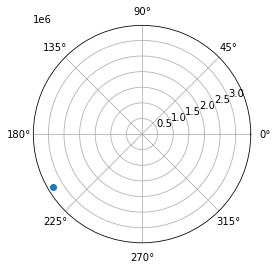

[4424856.9664643]
list is not none


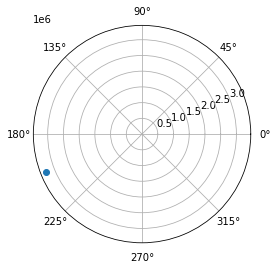

[4412366.987519347]
list is not none


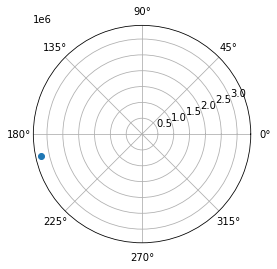

[4399946.345722701]
list is not none


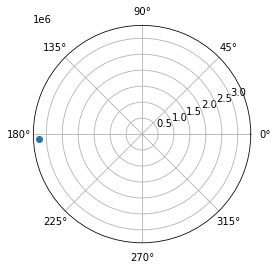

[4387595.776152405]
list is not none


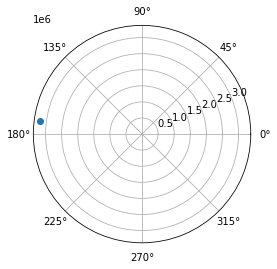

[4375316.017691252]
list is not none


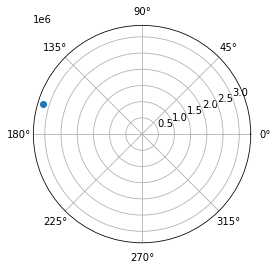

[4363107.812959654]
list is not none


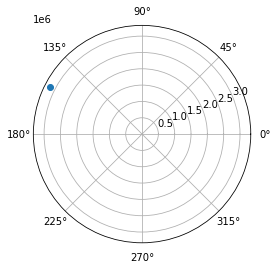

[4350971.908245185]
list is not none


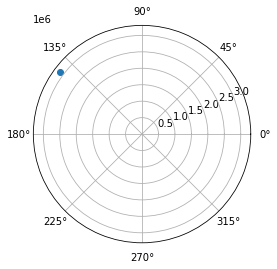

[4338909.053428765]
list is not none


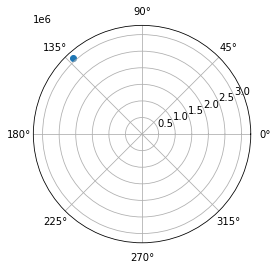

[4326920.001907417]
list is not none


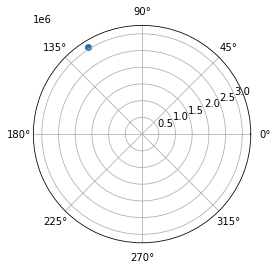

[4315005.51051356]
list is not none


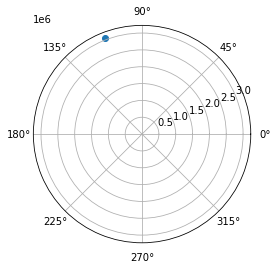

[4303166.33943071]
list is not none


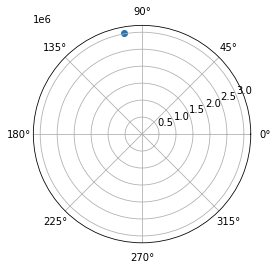

[4291403.252105615]
list is not none


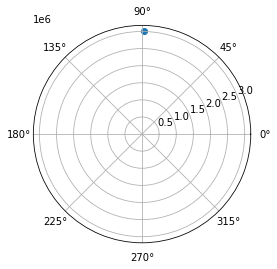

[4279717.015156685]
list is not none


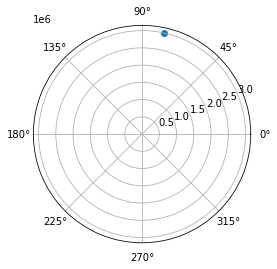

[4268108.398278729]
list is not none


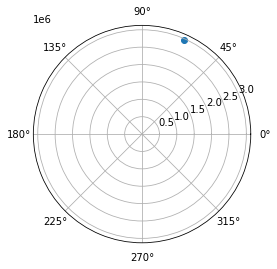

[4237023.2558350675]
list is not none


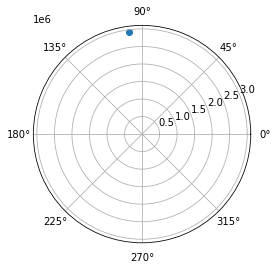

[4248482.096912516]
list is not none


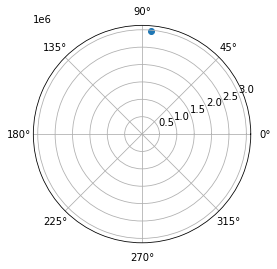

[4260022.252626573]
list is not none


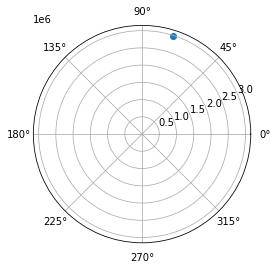

[4271642.947477285]
list is not none


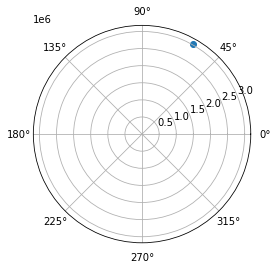

[4283343.408584333]
list is not none


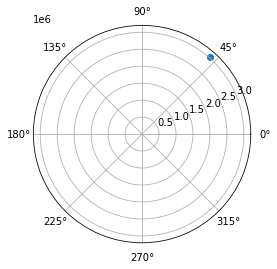

[4295122.865797145]
list is not none


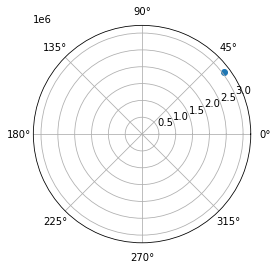

[4306980.551801086]
list is not none


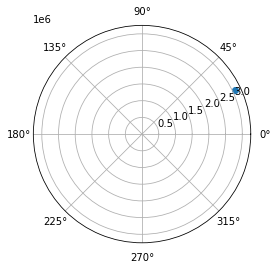

[4318915.702219782]
list is not none


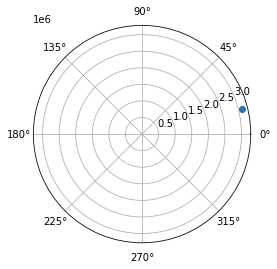

[4330927.555713647]
list is not none


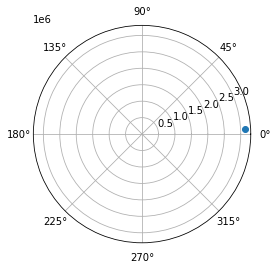

[4343015.354074642]
list is not none


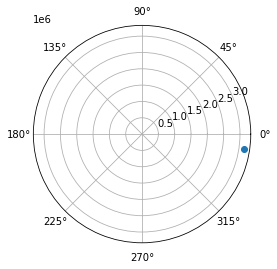

[4355178.342317325]
list is not none


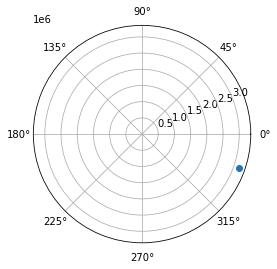

[4367415.768766276]
list is not none


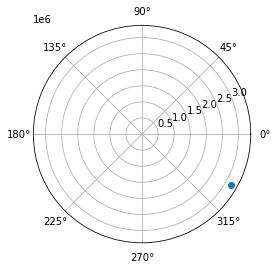

[4379726.885139915]
list is not none


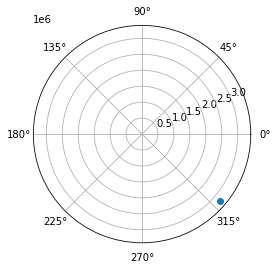

[4392110.946630802]
list is not none


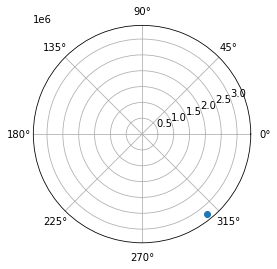

[4404567.211982478]
list is not none


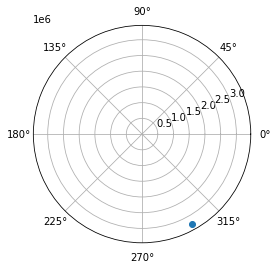

[4417094.9435628895]
list is not none


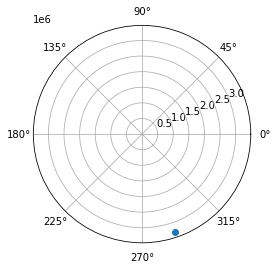

[4429693.40743447]
list is not none


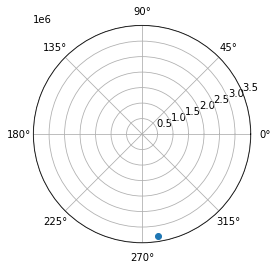

[4442361.873420956]
list is not none


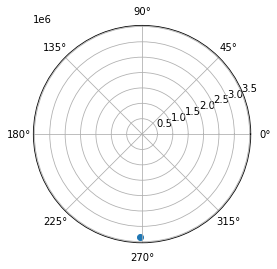

[4455099.615170972]
list is not none


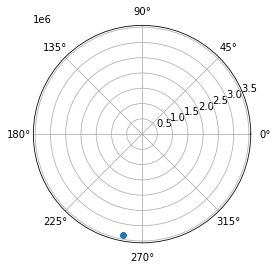

[4467905.9102184735]
list is not none


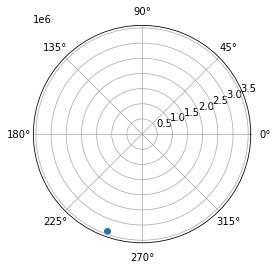

[4480780.0400401]
list is not none


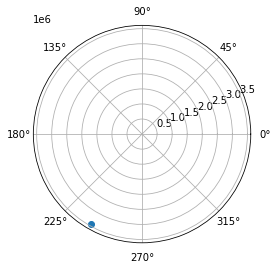

[4493721.290109503]
list is not none


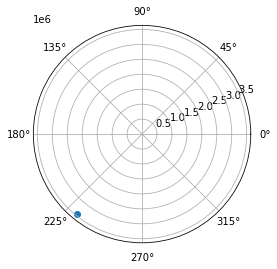

[4506728.9499487225]
list is not none


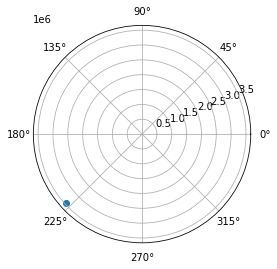

[4519802.313176665]
list is not none


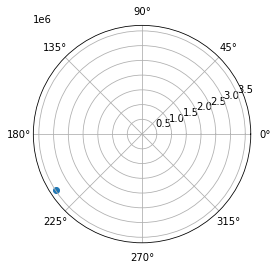

[4532940.677554759]
list is not none


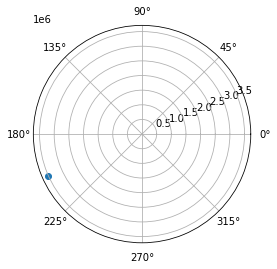

[4546143.345029846]
list is not none


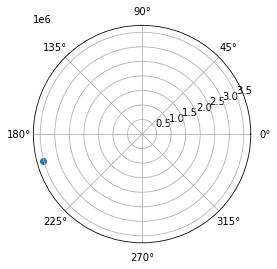

[4559409.62177438]
list is not none


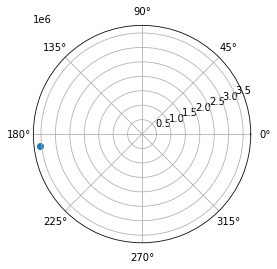

[4572738.81822398]
list is not none


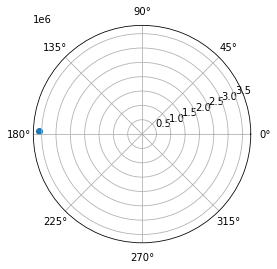

[6124439.061278946]
list is not none


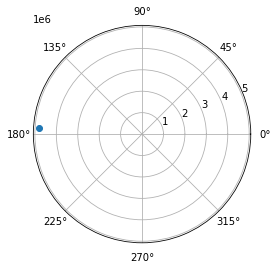

[6111322.6059324425]
list is not none


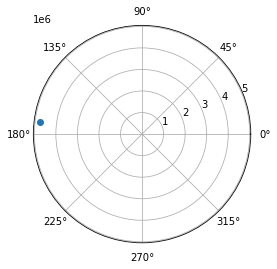

[6098248.483968088]
list is not none


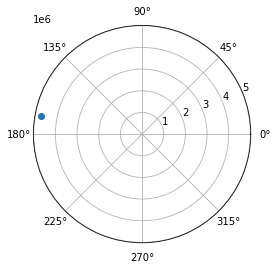

[6085217.081161166]
list is not none


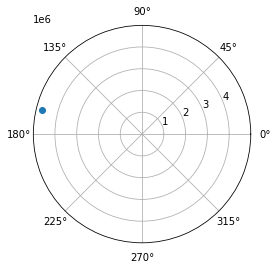

[6072228.785050857]
list is not none


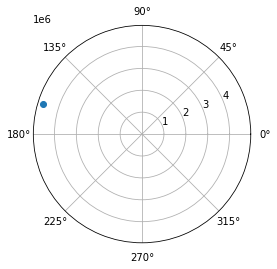

[6059283.98493062]
list is not none


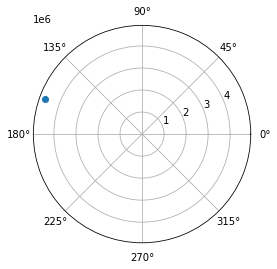

[6046383.071837975]
list is not none


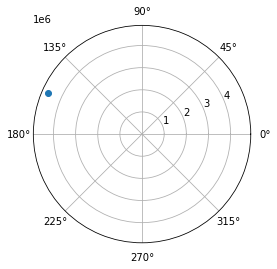

[6033526.438543769]
list is not none


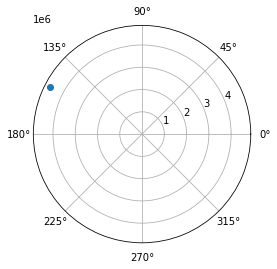

[6020714.479540817]
list is not none


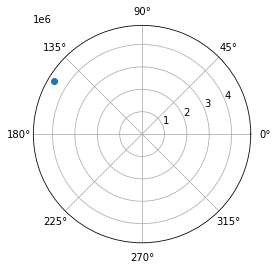

[6007947.591031998]
list is not none


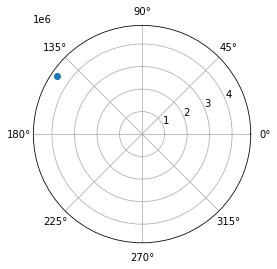

[5995226.170917711]
list is not none


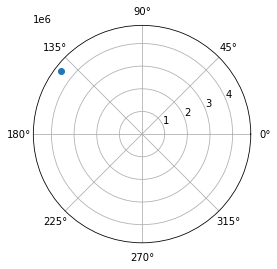

[5982550.618782765]
list is not none


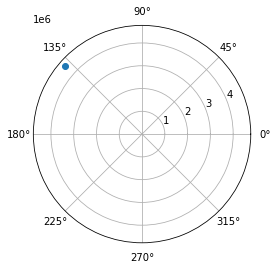

[5969921.335882615]
list is not none


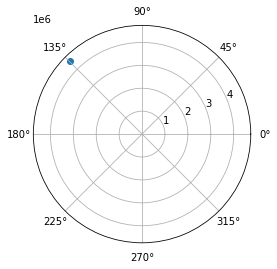

[5957338.725128991]
list is not none


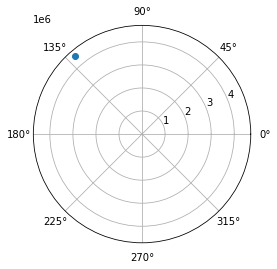

[5944803.191074864]
list is not none


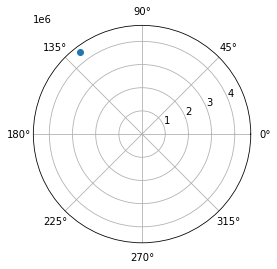

[5932315.139898772]
list is not none


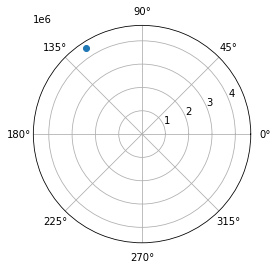

[5919874.979388477]
list is not none


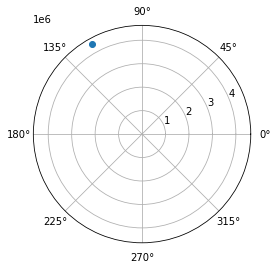

[5907483.118923958]
list is not none


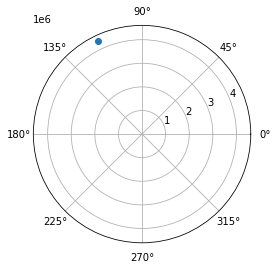

[5895139.969459702]
list is not none


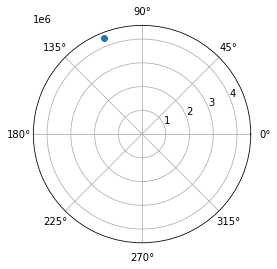

[5882845.943506304]
list is not none


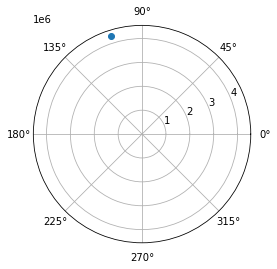

[5870601.455111361]
list is not none


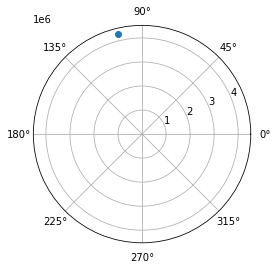

[5858406.919839647]
list is not none


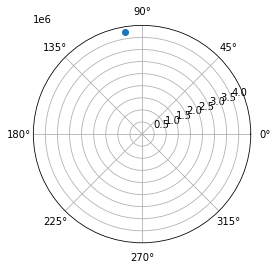

[5846262.7547525605]
list is not none


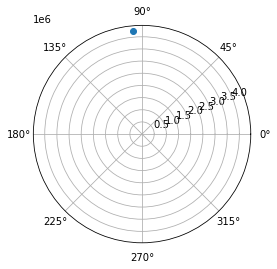

[5834169.378386824]
list is not none


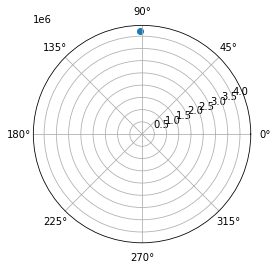

[5822127.210732445]
list is not none


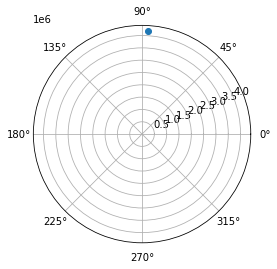

[4853282.645439724, 5810136.673209892]
list is not none


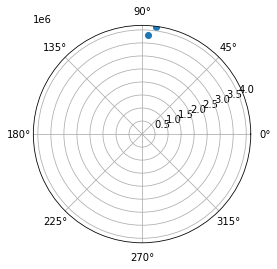

[4841740.619488614, 5798198.188646532]
list is not none


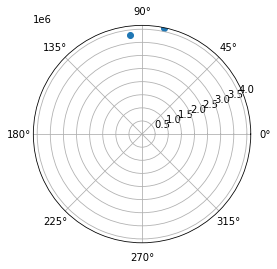

[4830253.222338354, 5786312.181252258]
list is not none


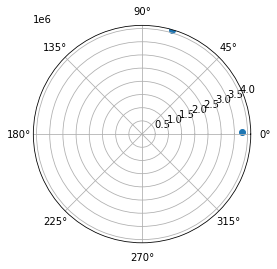

[4818820.942688046, 5774479.0765943285]
list is not none


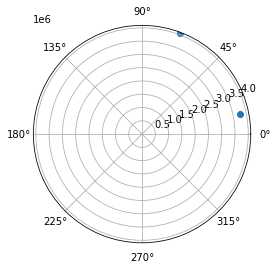

[4807444.271145355, 5762699.301571415]
list is not none


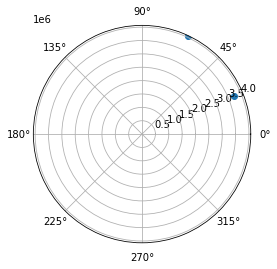

[4796123.7001915155, 5750973.284386824]
list is not none


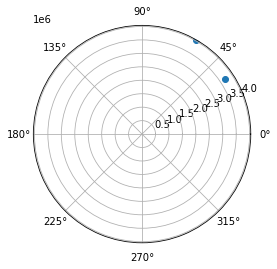

[4784859.724145032, 5739301.454520899]
list is not none


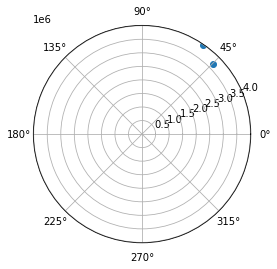

[4773652.839124025]
list is not none


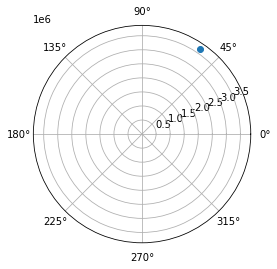

[4762503.543007226]
list is not none


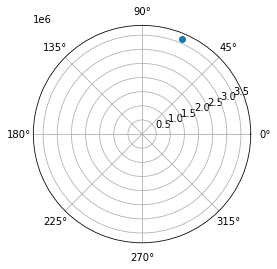

[4751412.335393571]
list is not none


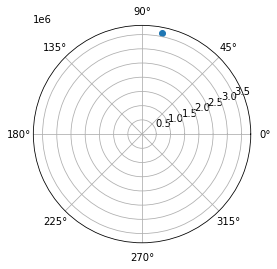

[4740379.717560433]
list is not none


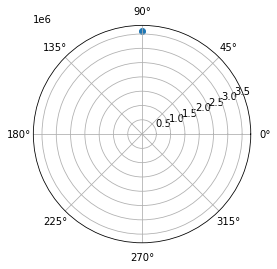

[4729406.192420395]
list is not none


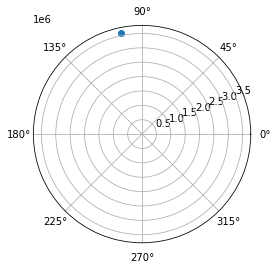

[4718492.264476605]
list is not none


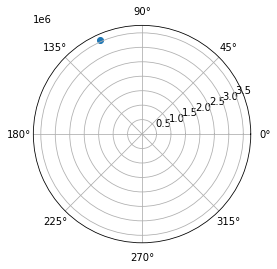

[4707638.43977668]
list is not none


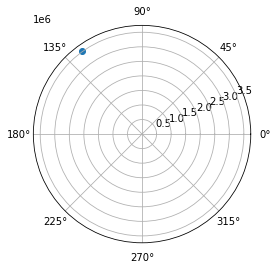

[4696845.22586514]
list is not none


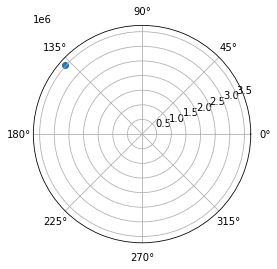

[4686113.131734332]
list is not none


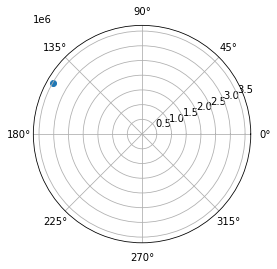

[4675442.667773869]
list is not none


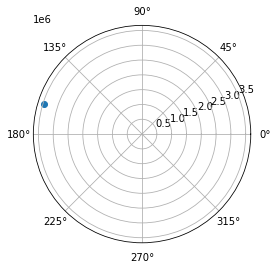

[4664834.345718557]
list is not none


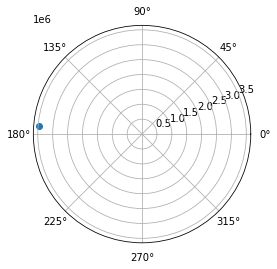

[4654288.678594748]
list is not none


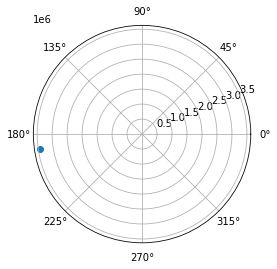

[4643806.180665178]
list is not none


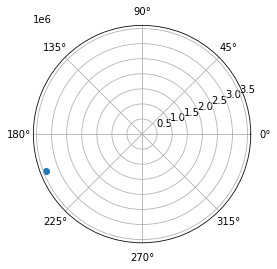

[4633387.367372222]
list is not none


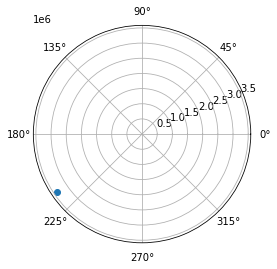

[4623032.7552795755]
list is not none


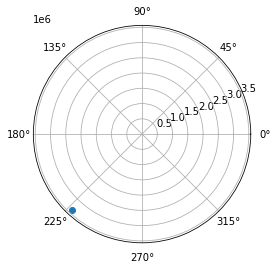

[4612742.862012338]
list is not none


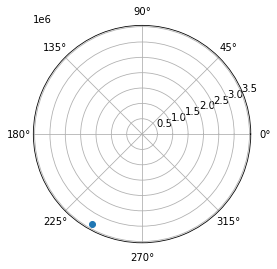

[4602518.2061955035]
list is not none


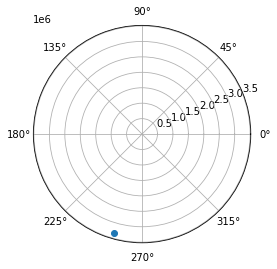

[4592359.307390825]
list is not none


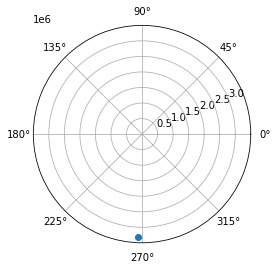

[4582266.686032065]
list is not none


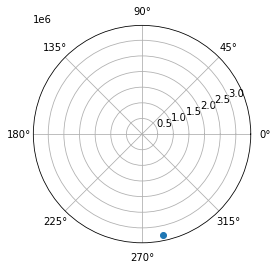

[4572240.863358588]
list is not none


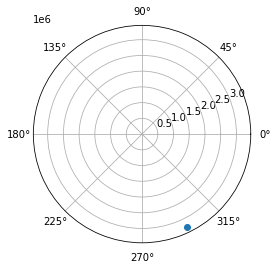

[4562282.3613473475]
list is not none


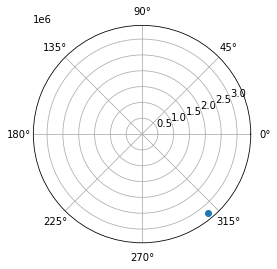

[4552391.702643178]
list is not none


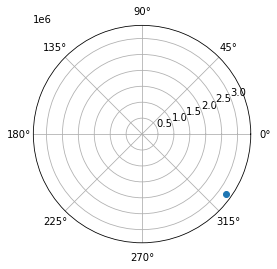

[4542569.410487474]
list is not none


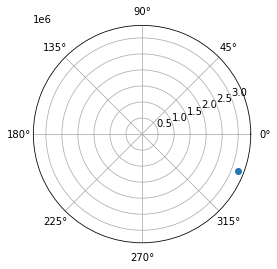

[4532816.008645161]
list is not none


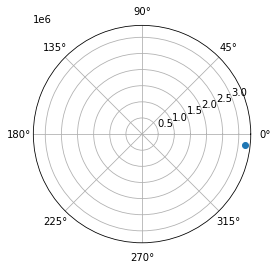

[4523132.0213300325]
list is not none


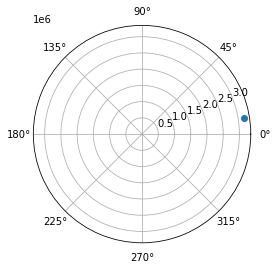

[4513517.973128393]
list is not none


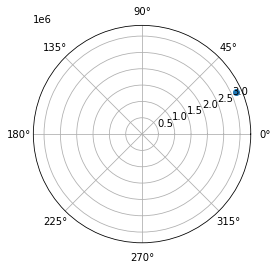

[4503974.388921044]
list is not none


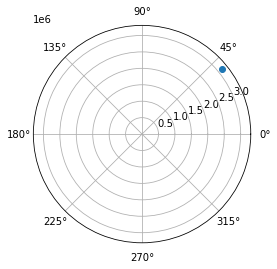

[4487273.733211268]
list is not none


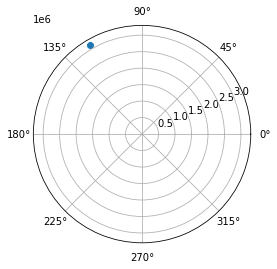

[4496531.825605453]
list is not none


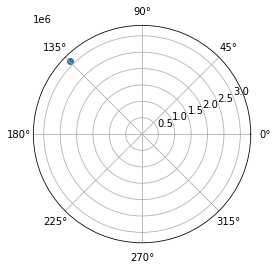

[4505857.29246942]
list is not none


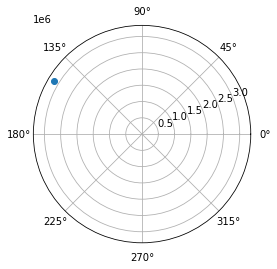

[4515249.597205426]
list is not none


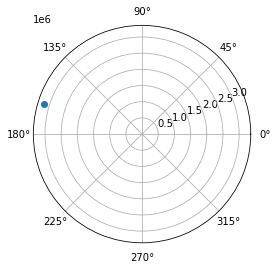

[4524708.2038119305]
list is not none


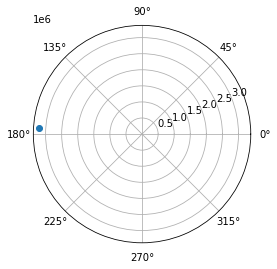

[4534232.576957516]
list is not none


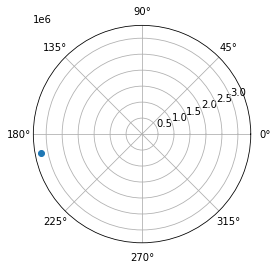

[4543822.182053098]
list is not none


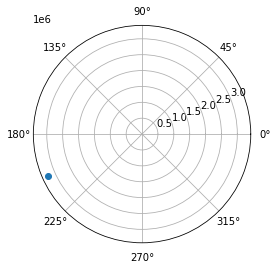

[4553476.485322479]
list is not none


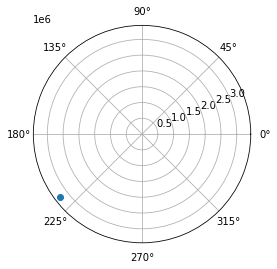

[4563194.953871207]
list is not none


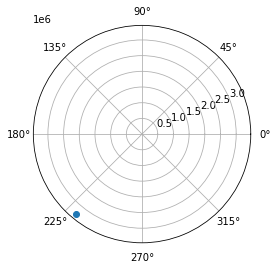

[4572977.055753771]
list is not none


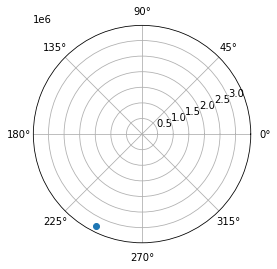

[4582822.260039135]
list is not none


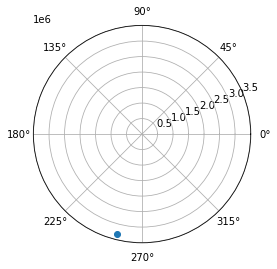

[4592730.036874636]
list is not none


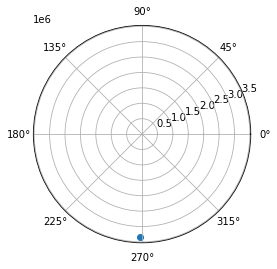

[4602699.857548213]
list is not none


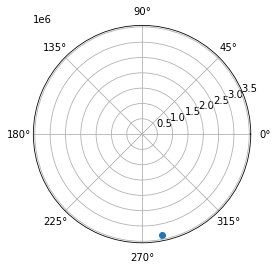

[4612731.194549029]
list is not none


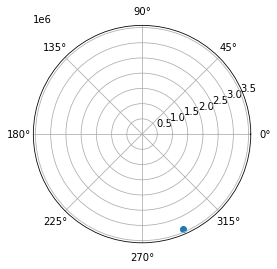

[4622823.5216264725]
list is not none


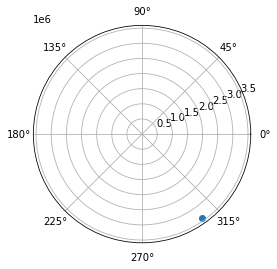

[4632976.3138475465]
list is not none


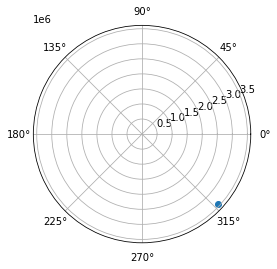

[4643189.047652675]
list is not none


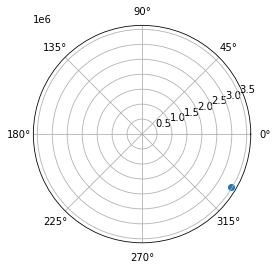

[4653461.200909926]
list is not none


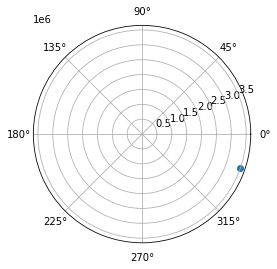

[4663792.252967671]
list is not none


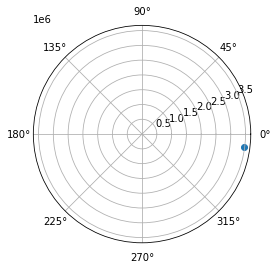

[4674181.684705713]
list is not none


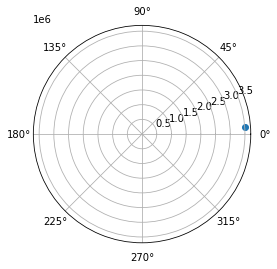

[4684628.978584862]
list is not none


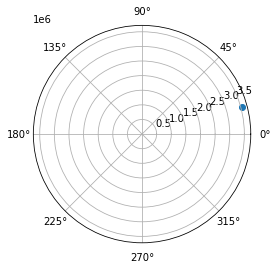

[4695133.618695011]
list is not none


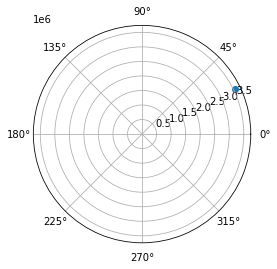

[4705695.090801709]
list is not none


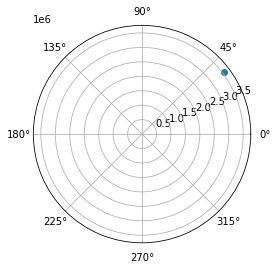

[4716312.882391259]
list is not none


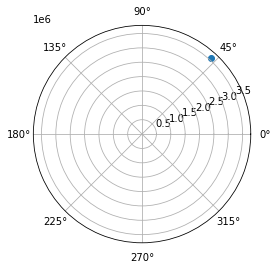

[4726986.48271435]
list is not none


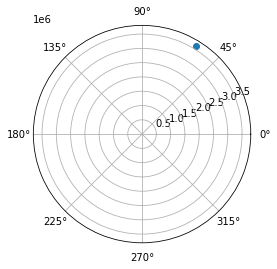

[4737715.382828248]
list is not none


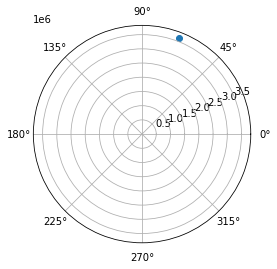

[4748499.075637558]
list is not none


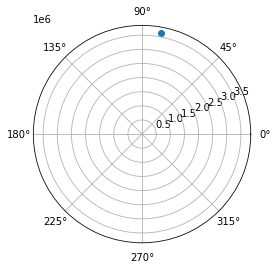

[4759337.0559335975]
list is not none


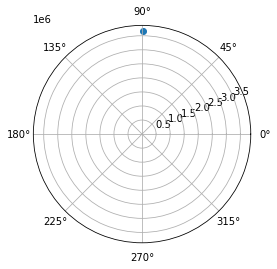

[4770228.820432359]
list is not none


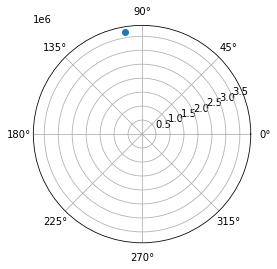

[4781173.867811131]
list is not none


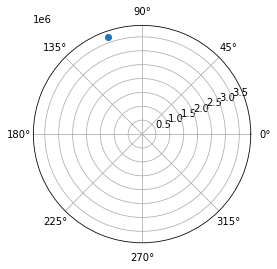

[4792171.698743757]
list is not none


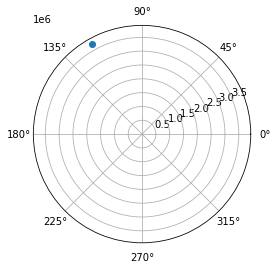

[4803221.815934572]
list is not none


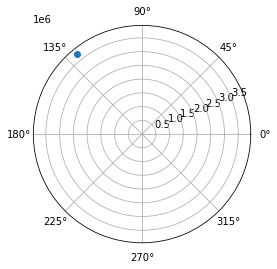

[4814323.724151045]
list is not none


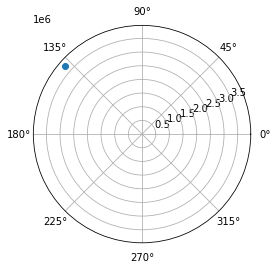

[4825476.930255124]
list is not none


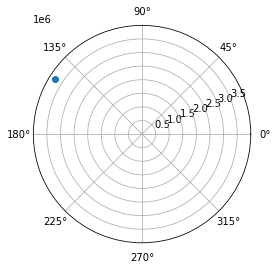

[5702119.099229082]
list is not none


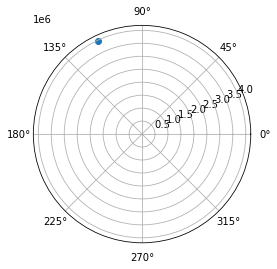

[5713494.513955267]
list is not none


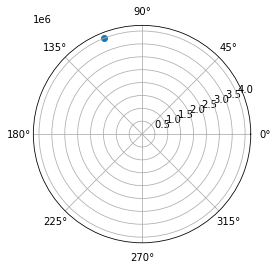

[5724923.445385288]
list is not none


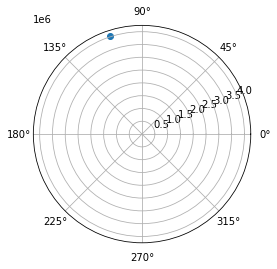

[5736405.459064263]
list is not none


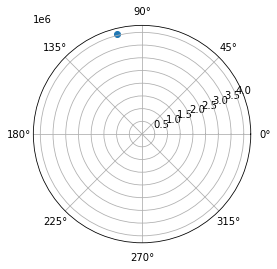

[5747940.121836945]
list is not none


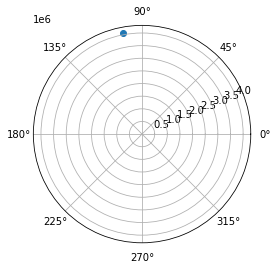

[5759527.0018757535]
list is not none


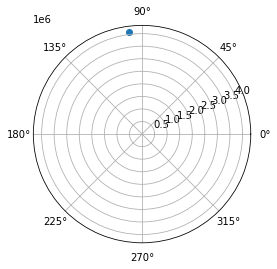

[5771165.668707925]
list is not none


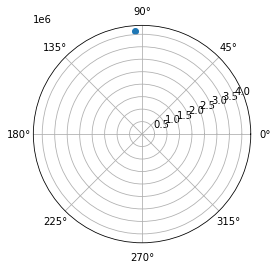

[5782855.693241863]
list is not none


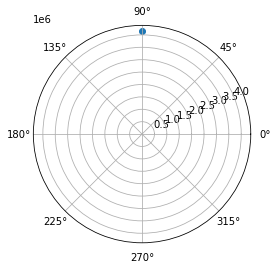

[5794596.64779268]
list is not none


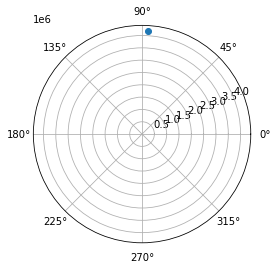

[5806388.106106907]
list is not none


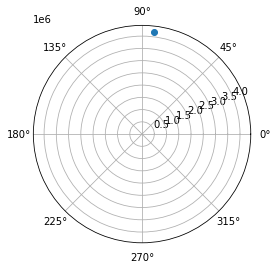

[5818229.643386455]
list is not none


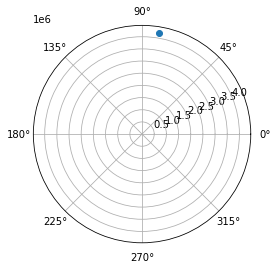

[5830120.8363117445]
list is not none


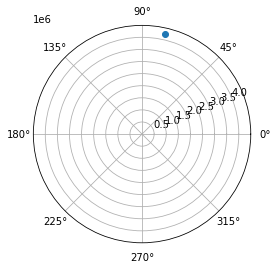

[5842061.26306409]
list is not none


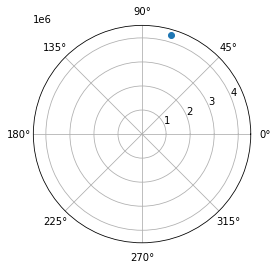

[5854050.503347338]
list is not none


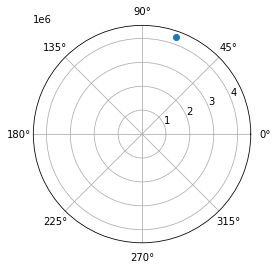

[5866088.138408714]
list is not none


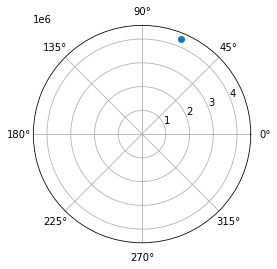

[5878173.751058964]
list is not none


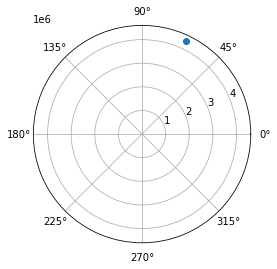

[5890306.925691749]
list is not none


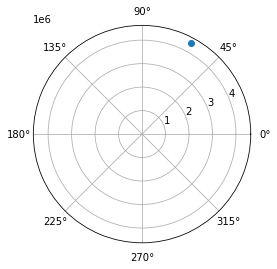

[5902487.248302331]
list is not none


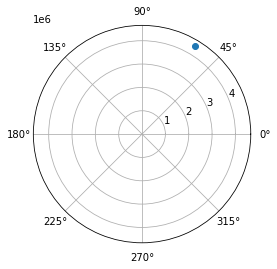

[5914714.306505549]
list is not none


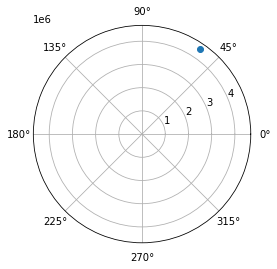

[5926987.689553097]
list is not none


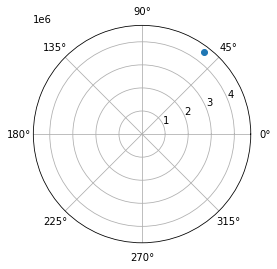

[5939306.98835012]
list is not none


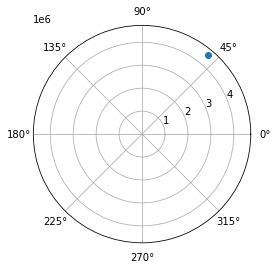

[5951671.795471139]
list is not none


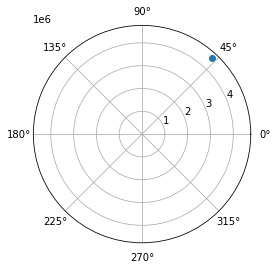

[5964081.705175307]
list is not none


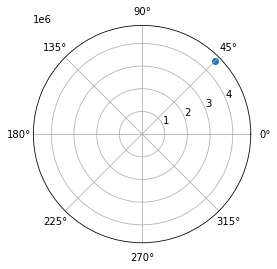

[5976536.31342101]
list is not none


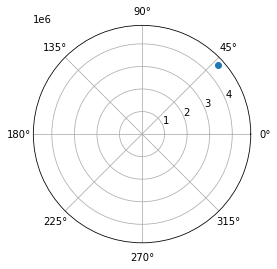

[5989035.217879844]
list is not none


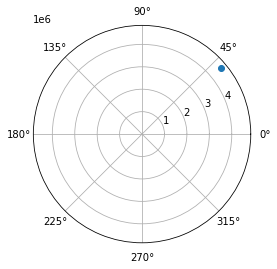

[6001578.017949947]
list is not none


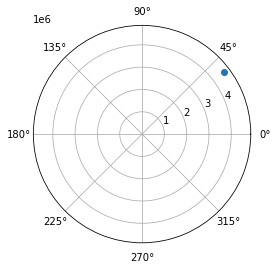

[6014164.314768726]
list is not none


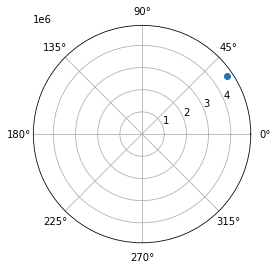

[6026793.7112249555]
list is not none


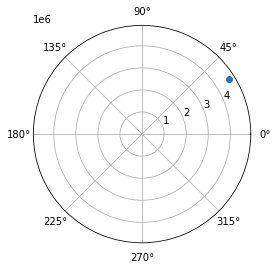

[6039465.81197031]
list is not none


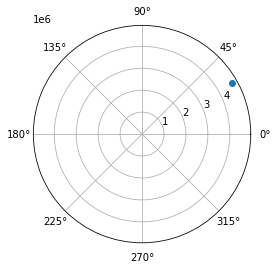

[6052180.223430279]
list is not none


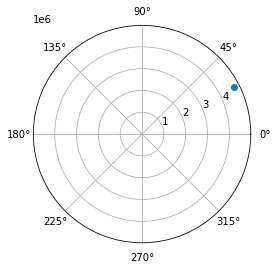

[6064936.553814538]
list is not none


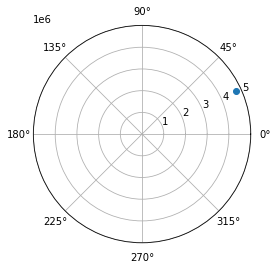

[6077734.413126727]
list is not none


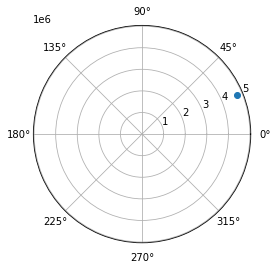

[6421764.113248598]
list is not none


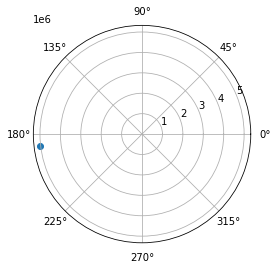

[6414728.3253138065]
list is not none


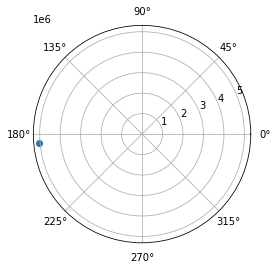

[6407705.372174078]
list is not none


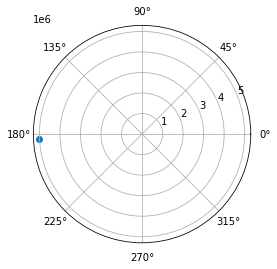

[6400695.31241619]
list is not none


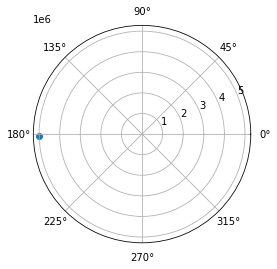

[6393698.204748962]
list is not none


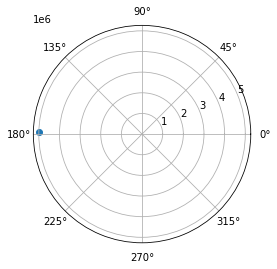

[6386714.108002649]
list is not none


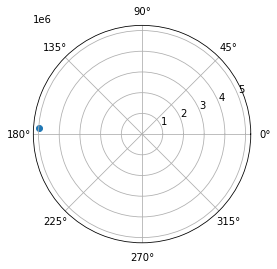

[6379743.081128356]
list is not none


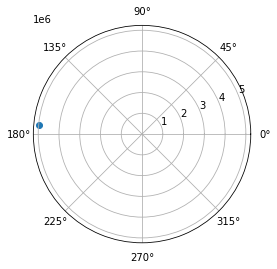

[6372785.183197418]
list is not none


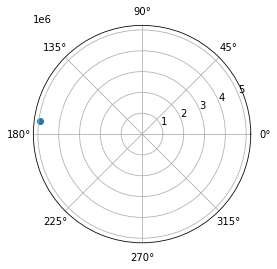

[6365840.473400774]
list is not none


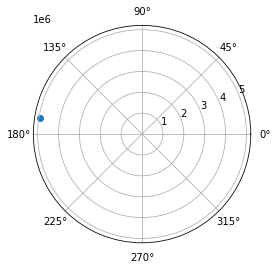

[6358909.011048329]
list is not none


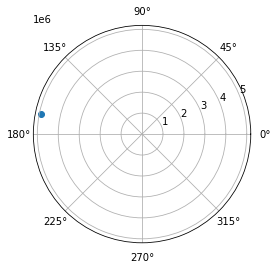

[6351990.855568313]
list is not none


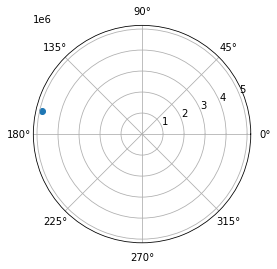

[6345086.066506587]
list is not none


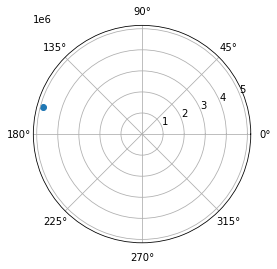

[6338194.703525996]
list is not none


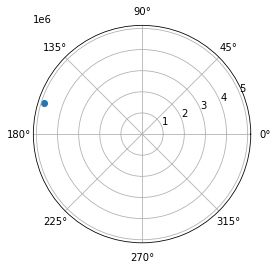

[6331316.826405659]
list is not none


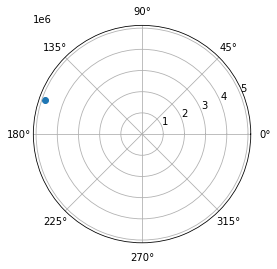

[6324452.4950402705]
list is not none


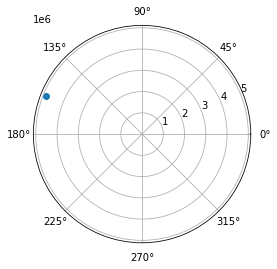

[6317601.769439378]
list is not none


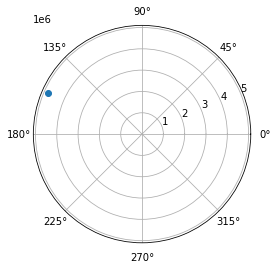

[6310764.709726653]
list is not none


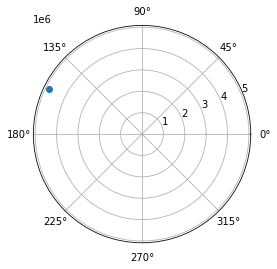

[6303941.376139141]
list is not none


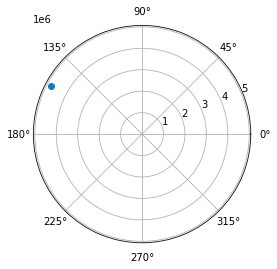

[6297131.829026504]
list is not none


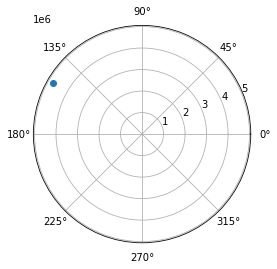

[6290336.128850247]
list is not none


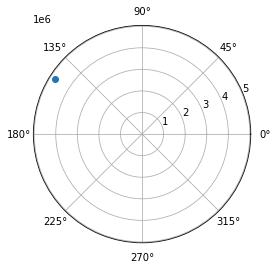

[6283554.336182923]
list is not none


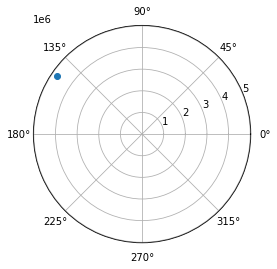

[6276786.511707342]
list is not none


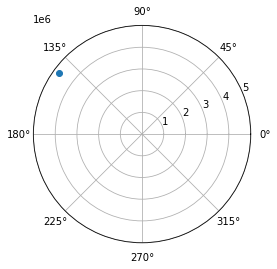

[6270032.716215736]
list is not none


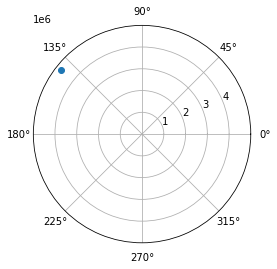

[6263293.010608953]
list is not none


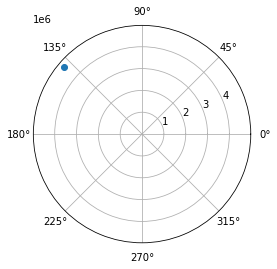

[6256567.455895583]
list is not none


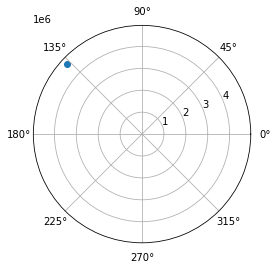

[6249856.113191116]
list is not none


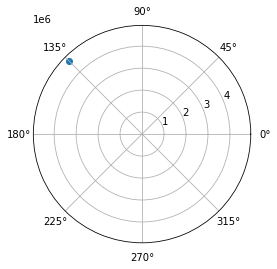

[6243159.043717067]
list is not none


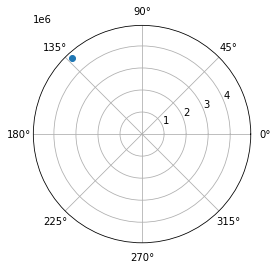

[6236476.308800071]
list is not none


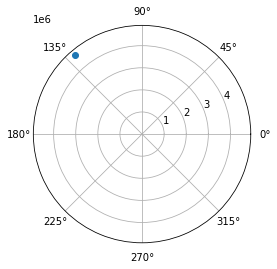

[6229807.969870996]
list is not none


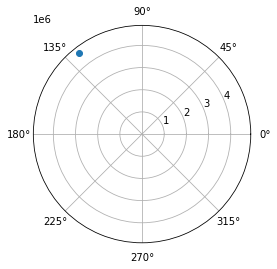

[6223154.088464005]
list is not none


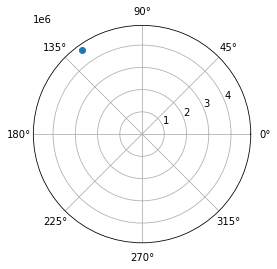

[6216514.726215631]
list is not none


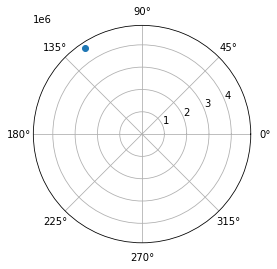

[6209889.944863821]
list is not none


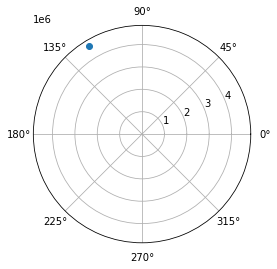

[6203279.806246979]
list is not none


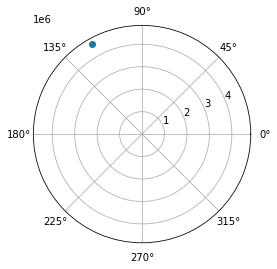

[6196684.3723029755]
list is not none


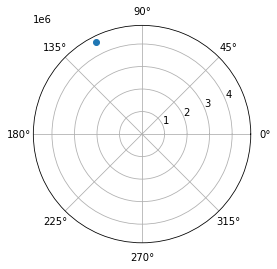

[6190103.705068148]
list is not none


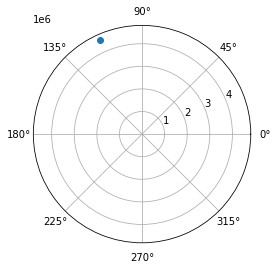

[6183537.866676288]
list is not none


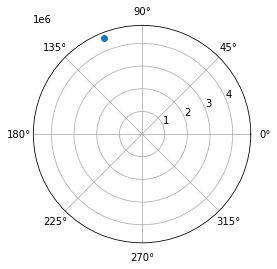

[6176986.9193576295]
list is not none


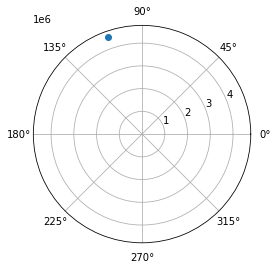

[6170450.925437777]
list is not none


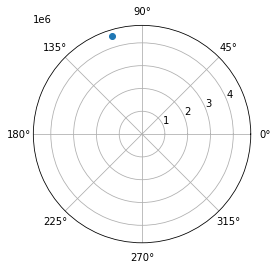

[6163929.947336667]
list is not none


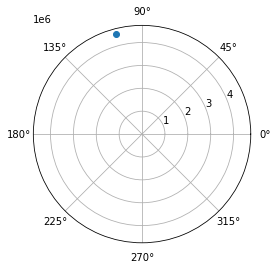

[6157424.047567479]
list is not none


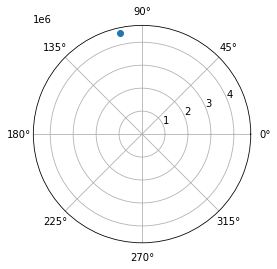

[6150933.288735542]
list is not none


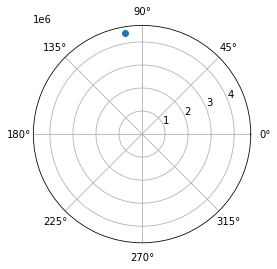

[6144457.733537233]
list is not none


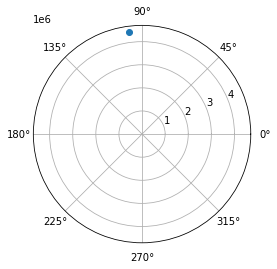

[6137997.444758841]
list is not none


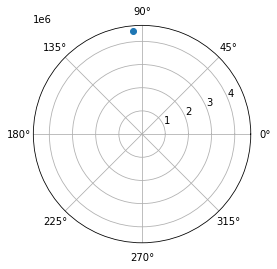

[6131552.485275433]
list is not none


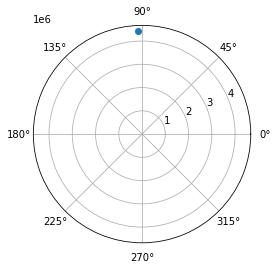

[6125122.918049699]
list is not none


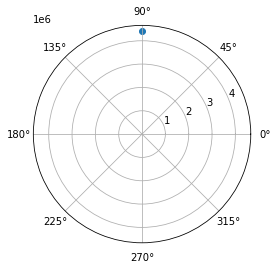

[6118708.806130754]
list is not none


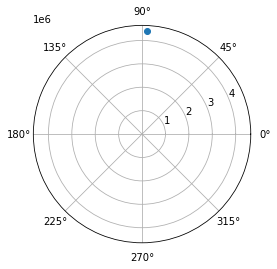

[6112310.212652976]
list is not none


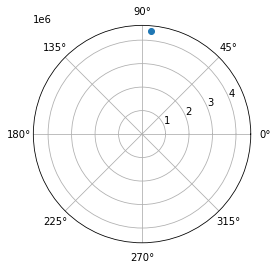

[6105927.200834765]
list is not none


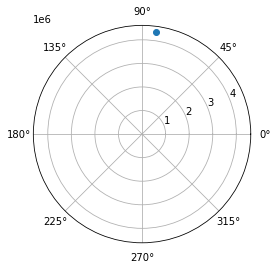

[6099559.83397735]
list is not none


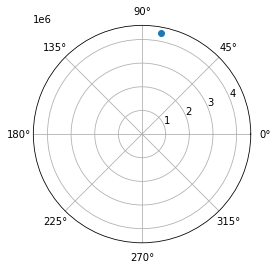

[6093208.175463523]
list is not none


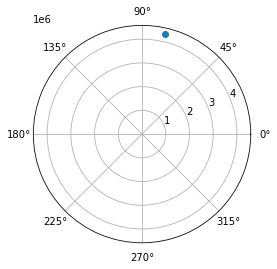

[6086872.288756381]
list is not none


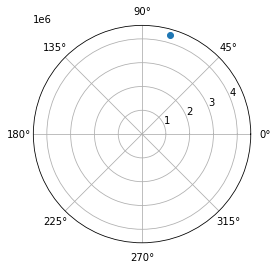

[6080552.237398047]
list is not none


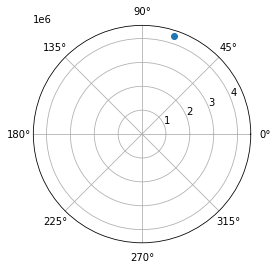

[6074248.085008394]
list is not none


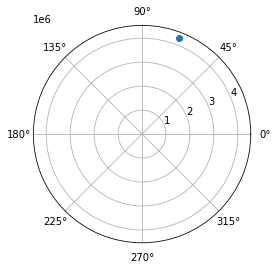

[6067959.8952837065]
list is not none


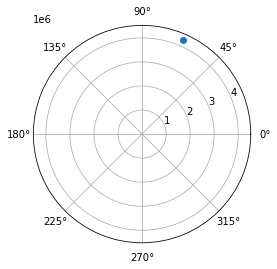

[6061687.731995367]
list is not none


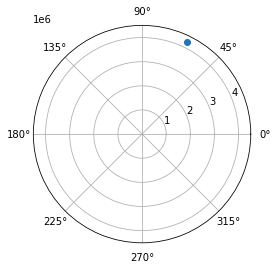

[6055431.658988504]
list is not none


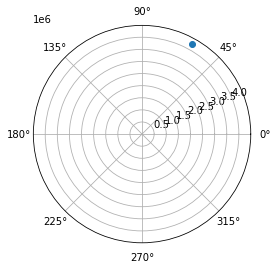

[6049191.740180624]
list is not none


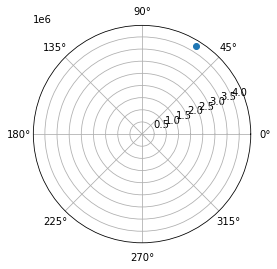

[6042968.039560238]
list is not none


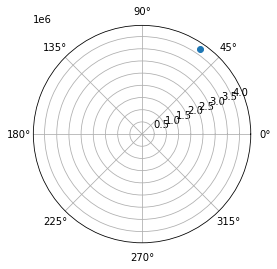

[6036760.621185443]
list is not none


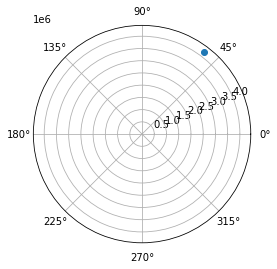

[6030569.549182528]
list is not none


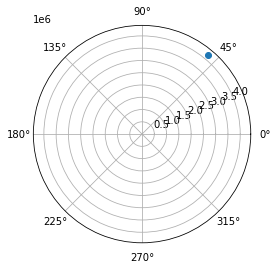

[6024394.887744519]
list is not none


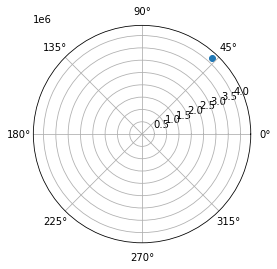

In [17]:
# obs_tele_pos_series = []
# tar_simu_pos_series = []


for j in range(3000):
    
    obs_tele_car = prop(obs_tele_car)

    r = np.array(obs_tele_car[:3])
    v = np.array(obs_tele_car[3:])
    rot = tele_trans_LVLH(r, v)

    theta_tmp = []
    phi_tmp = []
    R_tmp = []
    polar_tmp = []

    for i in range(len(hypo_tmp_car)):
        
        hypo_tmp_car[i] = prop(hypo_tmp_car[i])
        
        r_t = hypo_tmp_car[i][:3]
        r_v = hypo_tmp_car[i][3:]
        R, theta, phi = target_trans_LVLH(r, v, rot, r_t, r_v)
        
        diff_ta = theta - d_t[0]
        
        if abs(diff_ta) <= 4:
            
            R_tmp.append(R)
            theta_tmp.append(theta)
            phi_tmp.append(phi)
            polar = abs(R * np.sin((theta*np.pi)/180))
            polar_tmp.append(polar)
            
            name_ = str(i)
            dic[name_].append(2*j)
    
    if len(R_tmp):
        print(R_tmp)
        print('list is not none')
        plt.figure()
        ax1 = plt.subplot(111, projection='polar')
        ax1.scatter(phi_tmp, polar_tmp)
        plt.show()

In [18]:
# np.save('dic_time.npy', dic)

In [19]:
import pandas as pd

stat_pd = []
obs_time_tmp = []
for ii in range(20):
    name_ = str(ii)
    if len(dic[name_]):
#         print('{}   :   '.format(ii),len(dic[name_]))
        
        obs_time_tmp = []
        one_seg = dic['{}'.format(ii)]
        multi_seg = []
        for i in range(len(one_seg)-1):
            multi_seg.append(one_seg[i])
            if one_seg[i+1]-one_seg[i]>2:
                obs_time_tmp.append(multi_seg)
                multi_seg = []
            if i == len(one_seg)-2:
                multi_seg.append(one_seg[i+1])        
                obs_time_tmp.append(multi_seg)
        seg_num = len(obs_time_tmp)
        stat_pd.append([ii,len(dic[name_]),seg_num])

df = pd.DataFrame(stat_pd,columns=['number','total_num','segment_num'])
print(df)

   number  total_num  segment_num
0       1         88            2
1       3         56            2
2       4         68            2
3       5         64            2
4       7         54            2
5       8        166            2
6      16         61            1


In [20]:
index_row = df['total_num'].argmax()
dic_select = df.iloc[index_row, 0]

In [21]:
dic_select

8

In [22]:
# obs_time_tmp = []
# aad = dic['{}'.format(dic_select)]
# aad0 = []
# for i in range(len(aad)-1):
#     aad0.append(aad[i])
#     if aad[i+1]-aad[i]>2:
#         obs_time_tmp.append(aad0)
#         aad0 = []
#     if i == len(aad)-2:
#         aad0.append(aad[i+1])        
#         obs_time_tmp.append(aad0)

In [23]:
# len(obs_time_tmp)

In [24]:
ini_obs_tele_car

[2965763.4420625097,
 4826094.719358868,
 -3913217.97914458,
 -1133.3928993179804,
 -4300.855122498339,
 -6166.903337085192]

In [25]:
obs_tele_car_ = list(ini_obs_tele_car)
i = dic_select
hypo_tmp_car_ = np.load('high_hypo_tmp_car.npy')[i]

test = {'time':[]}

obs_tele_tmp_ = []
tar_sat_tmp_ = []
index_arc = []
# obs_tele_tmp_.append(obs_tele_car_)
# tar_sat_tmp_.append(hypo_tmp_car_)

for j in range(3000):
    
    obs_tele_car_ = prop(obs_tele_car_)
    
    r = np.array(obs_tele_car_[:3])
    v = np.array(obs_tele_car_[3:])
    rot = tele_trans_LVLH(r, v)

    theta_tmp = []
    phi_tmp = []
    R_tmp = []
    polar_tmp = []
        
    hypo_tmp_car_ = prop(hypo_tmp_car_)
 
    obs_tele_tmp_.append(obs_tele_car_)
    tar_sat_tmp_.append(hypo_tmp_car_)
    
    r_t = hypo_tmp_car_[:3]
    r_v = hypo_tmp_car_[3:]
    R, theta, phi = target_trans_LVLH(r, v, rot, r_t, r_v)

    diff_ta = theta - d_t[0]

    if abs(diff_ta) <= 4:

        R_tmp.append(R)
        theta_tmp.append(theta)
        phi_tmp.append(phi)
        polar = abs(R * np.sin((theta*np.pi)/180))
        polar_tmp.append(polar)

        test['time'].append(2*j+2)
        index_arc.append(j)
        # 未保存初始时刻，是从传播后的第一时刻开始保存的，且传播间隔为 2 s，所以（2*j+2）
    
#     if len(R_tmp):
#         print(R_tmp)
#         print('list is not none')
#         plt.figure()
#         ax1 = plt.subplot(111, projection='polar')
#         ax1.scatter(phi_tmp, polar_tmp)
#         plt.show()

In [26]:
test['time']

[2554,
 2556,
 2558,
 2560,
 2562,
 2564,
 2566,
 2568,
 2570,
 2572,
 2574,
 2576,
 2578,
 2580,
 2582,
 2584,
 2586,
 2588,
 2590,
 2592,
 2594,
 2596,
 2598,
 2600,
 2602,
 2604,
 2606,
 2608,
 2610,
 2612,
 2614,
 2616,
 2618,
 2620,
 2622,
 2624,
 2626,
 2628,
 2630,
 2632,
 2634,
 2636,
 2638,
 2640,
 2642,
 2644,
 2646,
 2648,
 2650,
 2652,
 2654,
 2656,
 2658,
 2660,
 2662,
 2664,
 2666,
 2668,
 2670,
 2672,
 2674,
 2676,
 2678,
 2680,
 2682,
 2684,
 2686,
 2688,
 2690,
 2692,
 2694,
 2696,
 2698,
 2700,
 2702,
 2704,
 2706,
 2708,
 2710,
 2712,
 2714,
 2716,
 2718,
 2748,
 2750,
 2752,
 2754,
 2756,
 2758,
 2760,
 2762,
 2764,
 2766,
 2768,
 2770,
 2772,
 2774,
 2776,
 2778,
 2780,
 2782,
 2784,
 2786,
 2788,
 2790,
 2792,
 2794,
 2796,
 2798,
 2800,
 2802,
 2804,
 2806,
 2808,
 2810,
 2812,
 2814,
 2816,
 2818,
 2820,
 2822,
 2824,
 2826,
 2828,
 2830,
 2832,
 2834,
 2836,
 2838,
 2840,
 2842,
 2844,
 2846,
 2848,
 2850,
 2852,
 2854,
 2856,
 2858,
 2860,
 2862,
 2864,
 2866,

In [27]:
list(ini_obs_tele_car)

[2965763.4420625097,
 4826094.719358868,
 -3913217.97914458,
 -1133.3928993179804,
 -4300.855122498339,
 -6166.903337085192]

In [28]:
# obs_tele_kep

In [29]:
obs_tele_kep = np.array([6.87489699e+06, 1.46505319e-03, 9.80000000e+01, 2.43999767e+02,
       4.60830654e+01, 1.68944643e+02])

obs_tele_car = kep2car(obs_tele_kep)

In [30]:
# one_segment = np.array(obs_time_tmp[0])+2
# one_segment

one_segment = np.array(index_arc)
one_segment

array([1276, 1277, 1278, 1279, 1280, 1281, 1282, 1283, 1284, 1285, 1286,
       1287, 1288, 1289, 1290, 1291, 1292, 1293, 1294, 1295, 1296, 1297,
       1298, 1299, 1300, 1301, 1302, 1303, 1304, 1305, 1306, 1307, 1308,
       1309, 1310, 1311, 1312, 1313, 1314, 1315, 1316, 1317, 1318, 1319,
       1320, 1321, 1322, 1323, 1324, 1325, 1326, 1327, 1328, 1329, 1330,
       1331, 1332, 1333, 1334, 1335, 1336, 1337, 1338, 1339, 1340, 1341,
       1342, 1343, 1344, 1345, 1346, 1347, 1348, 1349, 1350, 1351, 1352,
       1353, 1354, 1355, 1356, 1357, 1358, 1373, 1374, 1375, 1376, 1377,
       1378, 1379, 1380, 1381, 1382, 1383, 1384, 1385, 1386, 1387, 1388,
       1389, 1390, 1391, 1392, 1393, 1394, 1395, 1396, 1397, 1398, 1399,
       1400, 1401, 1402, 1403, 1404, 1405, 1406, 1407, 1408, 1409, 1410,
       1411, 1412, 1413, 1414, 1415, 1416, 1417, 1418, 1419, 1420, 1421,
       1422, 1423, 1424, 1425, 1426, 1427, 1428, 1429, 1430, 1431, 1432,
       1433, 1434, 1435, 1436, 1437, 1438, 1439, 14

In [31]:
# i = 12

# tar_car = list(hypo_tmp_car_)
# tele_car = list(obs_tele_car)
# obs_tele_tmp = []
# tar_sat_tmp = []
# time = {'time': []}


# obs_tele_tmp.append(tele_car)
# tar_sat_tmp.append(tar_car)
# time['time'].append(prop_time*0)

# for j in range(3000):
    
#     tele_car = prop(tele_car)     
#     tar_car = prop(tar_car)
    
#     obs_tele_tmp.append(tele_car)
#     tar_sat_tmp.append(tar_car)
    
#     time['time'].append(prop_time*(j+1))

In [32]:
# [list(one_segment)]

In [33]:
# np.array(test['time'])[list(one_segment)]

## 对某一个仿真轨道的观测数据处理，使其匹配到定轨算法

In [34]:
obs_pos_tele = np.array(obs_tele_tmp_)[list(one_segment)]
obs_pos_unkn = np.array(tar_sat_tmp_)[list(one_segment)]

In [35]:
sat_tele_diff = obs_pos_unkn - obs_pos_tele

In [36]:
from astropy import coordinates as coord
from astropy import units as u
from astropy.time import Time
import random
from datetime import datetime,timedelta

ra_tmp = []
dec_tmp = []
ini_instant = list(one_segment)[0]
start_time = datetime(2008,1,1,0,0,0) + timedelta(seconds = 2*int(ini_instant))  
# print(start_time)
for i in range(len(obs_pos_tele)):
    obs_time = start_time + timedelta(seconds = 2*int(list(one_segment)[i]) - 2*int(ini_instant))
#     print(obs_time)
    now = Time(obs_time)
    cartrep = coord.CartesianRepresentation(x=sat_tele_diff[i,0], 
                                            y=sat_tele_diff[i,1],
                                            z=sat_tele_diff[i,2], unit=u.m)
    gcrs = coord.GCRS(cartrep,obstime=now)

    ra = gcrs.ra.to(u.deg).to_value() + random.gauss(0,0.001)
    dec = gcrs.dec.to(u.deg).to_value() + random.gauss(0,0.001)
    ra_tmp.append(ra)
    dec_tmp.append(dec)

In [37]:
ini_date = datetime(2008,1,1,0,0,0) + timedelta(seconds = 2*int(ini_instant))  

obs_date = ini_date
rr = [obs_date.year,obs_date.month,obs_date.day, obs_date.hour, obs_date.minute, obs_date.second]

obs_1 = np.zeros((len(obs_pos_tele),11))
obs_1[0,:6] = [obs_date.year,obs_date.month,obs_date.day, obs_date.hour, obs_date.minute, obs_date.second]
obs_1[0,6:8] = [ra_tmp[0],dec_tmp[0]]
obs_1[0,8:11] = [np.array(obs_pos_tele)[0,0],np.array(obs_pos_tele)[0,1],np.array(obs_pos_tele)[0,2]]


for i in range(1,len(obs_pos_tele)):

    obs_date = start_time + timedelta(seconds = 2*int(list(one_segment)[i]) - 2*int(ini_instant))
    print(obs_date)
    obs_1[i,:6] = [obs_date.year,obs_date.month,obs_date.day, obs_date.hour, obs_date.minute, obs_date.second]
    obs_1[i,6:8] = [ra_tmp[i],dec_tmp[i]]
    obs_1[i,8:11] = [np.array(obs_pos_tele)[i][0],np.array(obs_pos_tele)[i][1],np.array(obs_pos_tele)[i][2]]

2008-01-01 00:42:34
2008-01-01 00:42:36
2008-01-01 00:42:38
2008-01-01 00:42:40
2008-01-01 00:42:42
2008-01-01 00:42:44
2008-01-01 00:42:46
2008-01-01 00:42:48
2008-01-01 00:42:50
2008-01-01 00:42:52
2008-01-01 00:42:54
2008-01-01 00:42:56
2008-01-01 00:42:58
2008-01-01 00:43:00
2008-01-01 00:43:02
2008-01-01 00:43:04
2008-01-01 00:43:06
2008-01-01 00:43:08
2008-01-01 00:43:10
2008-01-01 00:43:12
2008-01-01 00:43:14
2008-01-01 00:43:16
2008-01-01 00:43:18
2008-01-01 00:43:20
2008-01-01 00:43:22
2008-01-01 00:43:24
2008-01-01 00:43:26
2008-01-01 00:43:28
2008-01-01 00:43:30
2008-01-01 00:43:32
2008-01-01 00:43:34
2008-01-01 00:43:36
2008-01-01 00:43:38
2008-01-01 00:43:40
2008-01-01 00:43:42
2008-01-01 00:43:44
2008-01-01 00:43:46
2008-01-01 00:43:48
2008-01-01 00:43:50
2008-01-01 00:43:52
2008-01-01 00:43:54
2008-01-01 00:43:56
2008-01-01 00:43:58
2008-01-01 00:44:00
2008-01-01 00:44:02
2008-01-01 00:44:04
2008-01-01 00:44:06
2008-01-01 00:44:08
2008-01-01 00:44:10
2008-01-01 00:44:12


In [38]:
i=0
f=open("obs_simu_high.txt","w")

while i < len(obs_1): 
    

    for j in range(11):
        f.write(str(float(obs_1[i][j])))
        f.write(' ') 
    f.write('\n')
    
    i += 1
    
f.close()

In [39]:
list(car2kep(hypo_tmp_car_))

[11503554.711752253,
 0.01859061032281458,
 16.917494160598384,
 134.69895765629497,
 30.36565689561653,
 152.79280554059758]

In [40]:
#    a:  11022046.200766573
#  ecc:  0.016859170087893567
#  inc:  172.36702845779504
# raan:  226.09595641583294
#    w:  200.85052511014214
#    M:  128.7794098733538
